### INITIAL PROCESSING OF THE DATASET (FoodRecognition 2022)

### Deletion of various classes we didn't want
-Beverages / Liquids <br>
-Oils / Sauces / Condiments / Dressings <br>
-Misc / Pre-made desserts / soups

In [9]:
import json

meta_file = 'dataset/meta.json'
with open(meta_file, 'r') as f:
    meta = json.load(f)
classes = meta['classes']

class_dict = {}
for i, class_name in enumerate(classes):
    # print(f"Class ID: {class_name['id']}: {class_name['title']}")
    # create dictionary for name and id
    class_dict[class_name['id']] = class_name['title']
# print(class_dict)

remove_ids = [
        # Beverages / Liquids
        3419, 3787, 3807, 3435, 3439, 3457, 3517, 3541, 3547, 3727, 3729, 3865, 3867, 3707, 3709, 4185, 4187,
        3523, 3525, 3741, 3747, 3755, 3775, 4293, 4303, 4329,
        3459, 3783, 4029, 4301, 4387,
        4117, 4053, 4027, 4035,
        # Oils / Sauces / Condiments / Dressings
        3515, 3519, 3585, 3567, 3569, 4133, 4135, 4055, 4057, 4127, 4285, 4211,
        3769, 3709, 3711, 3747, 3749, 4305, 4343, 4365,
        3417, 4113, 4115, 4283, 4035, 3803, 4203,
        4009, 3825, 3711,
        3475, 3711, 4199, 4339,
        # Misc / Pre-made desserts / soups
        3521, 3569, 3571, 3701, 4105, 4171,
        3439, 3435, 3465, 3487, 3489, 3499, 3539, 3545, 3559, 3567, 3587, 3595, 3599, 3601, 3609, 3611, 3619, 3623,
        3635, 3637, 3641, 3645, 3655, 3667, 3673, 3683, 3685, 3687, 3693, 3695, 3703, 3705, 3717, 3721, 3725, 3727,
        3735, 3745, 3747, 3753, 3755, 3757, 3763, 3765, 3767, 3769, 3771, 3773, 3775, 3781, 3783, 3785, 3791, 3793,
        3795, 3801, 3803, 3805, 3811, 3817, 3825, 3827, 3831, 3833, 3835, 3841, 3843, 3845, 3847, 3849, 3851, 3853,
        3855, 3857, 3861, 3863, 3865, 3867, 3869, 3871, 3875, 3877, 3881, 3889, 3895, 3897, 3903, 3905, 3911, 3913,
        3915, 3917, 3921, 3923, 3927, 3929, 3931, 3933, 3935, 3937, 3939, 3943, 3945, 3947, 3951, 3953, 3955
    ]

for rid in remove_ids:
    if rid in class_dict:
        # print(f"Removing Class ID: {rid}: {class_dict[rid]}")
        del class_dict[rid]

print(f"Remaining classes count: {len(class_dict)}")

# for cid, cname in class_dict.items():
#     print(f"Class ID: {cid}: {cname}")


Remaining classes count: 335


In [ ]:
from collections import defaultdict
import os

def count_class_occurrences(ann_folder, keep_classes):
    """
    Counts the number of times each class appears in annotation files.
    """
    counts = defaultdict(int)
    
    for filename in os.listdir(ann_folder):
        if filename.endswith(".json"):
            file_path = os.path.join(ann_folder, filename)
            with open(file_path, 'r', encoding='utf-8') as f:
                data = json.load(f)
            
            for obj in data.get("objects", []):
                class_id = obj.get("classId")
                if class_id in keep_classes:
                    counts[class_id] += 1
    
    for class_id in keep_classes:
        if class_id not in counts:
            counts[class_id] = 0
    
    return dict(counts)

ann_folder = "dataset/train/ann"
class_counts = count_class_occurrences(ann_folder, class_dict)
class_counts_named = [(cid, class_dict[cid], count) for cid, count in class_counts.items()]
class_counts_named.sort(key=lambda x: x[2], reverse=True)
for cid, name, count in class_counts_named:
    print(f"{name} ({cid}): {count}")

dict_iter2 = {}
for cid, count in class_counts.items():
    if count >= 100:
        dict_iter2[cid] = class_dict[cid]

print(f"Final classes count (>=100 occurrences): {len(dict_iter2)}")
class_counts = count_class_occurrences(ann_folder, dict_iter2)
class_counts_named = [(cid, class_dict[cid], count) for cid, count in class_counts.items()]
class_counts_named.sort(key=lambda x: x[2], reverse=True)
for cid, name, count in class_counts_named:
    print(f"{name} ({cid}): {count}")

tomato-raw (3463): 3226
bread-white (3617): 2221
carrot-raw (3471): 2183
bread-wholemeal (3415): 1670
egg (3453): 1249
mixed-vegetables (3497): 1178
rice (3543): 1171
apple (3501): 1108
cucumber (3505): 1077
bell-pepper-red-raw (3553): 968
banana (3423): 832
espresso-with-caffeine (3789): 704
avocado (3445): 674
hard-cheese (3429): 660
tea (3441): 614
zucchini (3555): 607
bread-whole-wheat (3731): 555
tomato-sauce (3485): 546
strawberries (3983): 532
black-olives (3591): 517
chicken (3461): 496
parmesan (3593): 485
onion (3733): 483
blueberries (3503): 480
feta (3879): 459
tofu (4077): 454
red-radish (3997): 426
chickpeas (3473): 424
pasta-spaghetti (3589): 422
dark-chocolate (3671): 417
almonds (3493): 376
leaf-spinach (3661): 374
braided-white-loaf (3797): 362
salami (3533): 358
mixed-nuts (3973): 356
salmon (3575): 347
pizza-margherita-baked (3531): 344
soft-cheese (3425): 326
cucumber-pickled (3563): 322
salmon-smoked (3443): 318
gruyere (3899): 309
mushroom (3535): 308
hummus (373

### Deleting other beverages and sauces classes

In [ ]:
remove_classes = [
    # Beverages
    3789, 3909, 3743, 3449, 3441, 4255,
    # Sauces / dressings / condiments
    3479, 3715, 3565, 4073, 3659, 3597, 3437, 3829, 3737, 4089, 4005
]

# Create a new dictionary with unwanted classes removed
final_classes = {cid: name for cid, name in dict_iter2.items() if cid not in remove_classes}

print(f"Classes after removing beverages and sauces/dressings: {len(final_classes)}")
for cid, name in final_classes.items():
    print(f"{name} ({cid})")

Classes after removing beverages and sauces/dressings: 115
sugar-melon (4191)
carrot-raw (3471)
black-olives (3591)
feta (3879)
cucumber (3505)
salmon (3575)
tomato-raw (3463)
avocado (3445)
egg (3453)
apple (3501)
banana (3423)
witloof-chicory (4059)
ham (3451)
berries (4183)
pizza-margherita-baked (3531)
almonds (3493)
mushrooms (3615)
beef (4219)
rice (3543)
lemon (4221)
muesli (3925)
mixed-vegetables (3497)
salami (3533)
bell-pepper-red-raw (3553)
tuna (3669)
leaf-spinach (3661)
walnut (3885)
apple-pie (4165)
french-beans (3651)
lentils (3495)
hamburger-bread-meat-ketchup (3699)
hard-cheese (3429)
semi-hard-cheese (4021)
soft-cheese (3425)
bread-white (3617)
ham-cooked (3551)
zucchini (3555)
bread-wholemeal (3415)
kiwi (3649)
capers (3991)
sausage (3529)
orange (3581)
mixed-nuts (3973)
dried-raisins (3675)
pasta-spaghetti (3589)
ham-raw (3427)
bread-whole-wheat (3731)
onion (3733)
quinoa (4083)
mandarine (3647)
fennel (3957)
pasta-penne (3643)
cheese-for-raclette (3613)
dried-meat 

In [ ]:
segmentation_dict = {
    "meat": [
        "ham", "ham-cooked", "ham-raw", "salami", "sausage",
        "beef", "beef-minced-only-meat", "chicken",
        "chicken-cut-into-stripes-only-meat", "dried-meat",
        "shrimp-prawn-large", "bacon-frying", "tuna", "salmon",
        "salmon-smoked", "hamburger-bread-meat-ketchup"
    ],
    "fruit": [
        "apple", "banana", "berries", "lemon", "kiwi", "mandarine",
        "orange", "apricots", "blueberries", "pomegranate",
        "pineapple", "plums", "peach", "nectarine", "raspberries",
        "strawberries", "sugar-melon", "apple-pie", "croissant", 
        "birchermuesli-prepared-no-sugar-added"
    ],
    "vegetables": [
        "carrot-raw", "carrot-steamed-without-addition-of-salt", "black-olives",
        "cucumber", "tomato-raw", "witloof-chicory", "mushrooms",
        "mixed-vegetables", "bell-pepper-red-raw", "leaf-spinach",
        "french-beans", "lentils", "zucchini", "onion", "fennel",
        "red-cabbage", "vegetables", "eggplant", "cucumber-pickled",
        "red-radish", "kolhrabi", "sun-dried-tomatoe", "chickpeas",
        "green-asparagus", "peas", "spring-onion-scallion",
        "pizza-with-vegetables-baked", "green-bean-steamed-without-addition-of-salt"
    ],
    "cheese-dairy": [
        "feta", "egg", "hard-cheese", "semi-hard-cheese", "soft-cheese",
        "cheese-for-raclette", "parmesan", "cottage-cheese", "goat-cheese-soft",
        "gruyere"
    ],
    "nuts-seeds": [
        "almonds", "walnut", "mixed-nuts", "cashew-nut",
        "pumpkin-seeds", "pine-nuts"
    ],
    "bread-pasta-grains": [
        "bread-white", "bread-wholemeal", "bread-whole-wheat", "bread-wholemeal-toast",
        "bread-nut", "croissant", "braided-white-loaf", "roll-of-half-white-or-white-flour-with-large-void",
        "bread-half-white", "gluten-free-bread", "bread-toast", "bread-sourdough",
        "pasta-spaghetti", "pasta-penne", "pasta-twist", "pasta-noodles",
        "pasta-linguini-parpadelle-tagliatelle", "pasta",
        "quinoa", "rice", "muesli", "birchermuesli-prepared-no-sugar-added",
        "grits-polenta-maize-flour", "fajita-bread-only"
    ],
    "sweets-desserts": [
        "chocolate", "dark-chocolate", "cookies", "apple-pie"
    ],
    "miscellaneous": [
        "capers", "tomato-sauce", "vegetables"
    ]
}

final_class_names = set(final_classes.values())
segmentation_class_names = set()
for category in segmentation_dict.values():
    segmentation_class_names.update(category)

only_in_final = final_class_names - segmentation_class_names

only_in_segmentation = segmentation_class_names - final_class_names

print(f"Classes in final_classes but NOT in segmentation_dict ({len(only_in_final)}):")
for cls in sorted(only_in_final):
    print(cls)

print(f"\nClasses in segmentation_dict but NOT in final_classes ({len(only_in_segmentation)}):")
for cls in sorted(only_in_segmentation):
    print(cls)



Classes in final_classes but NOT in segmentation_dict (8):
avocado
beans-kidney
beetroot-steamed-without-addition-of-salt
corn
dried-raisins
mushroom
pizza-margherita-baked
tofu

Classes in segmentation_dict but NOT in final_classes (0):


In [ ]:
segmentation_dict["fruit"].extend(["avocado", "dried-raisins"])
segmentation_dict["vegetables"].extend([
    "beans-kidney", "beetroot-steamed-without-addition-of-salt", "corn", "mushroom"
])
segmentation_dict.setdefault("prepared_foods", []).append("pizza-margherita-baked")
segmentation_dict.setdefault("plant-protein", []).append("tofu")

    


Updated segmentation dictionary check:
Classes in final_classes but NOT in segmentation_dict (0):

Classes in segmentation_dict but NOT in final_classes (0):


In [33]:
print("\nUpdated segmentation dictionary check:")
# Re-check after updates
segmentation_class_names = set()
for category in segmentation_dict.values():
    segmentation_class_names.update(category)
only_in_final = final_class_names - segmentation_class_names
only_in_segmentation = segmentation_class_names - final_class_names
print(f"Classes in final_classes but NOT in segmentation_dict ({len(only_in_final)}):")
for cls in sorted(only_in_final):
    print(cls)
print(f"\nClasses in segmentation_dict but NOT in final_classes ({len(only_in_segmentation)}):")
for cls in sorted(only_in_segmentation):
    print(cls)


Updated segmentation dictionary check:
Classes in final_classes but NOT in segmentation_dict (0):

Classes in segmentation_dict but NOT in final_classes (0):


### Grouping classes into smaller groups (for classification models purposes)

In [ ]:
segmentation_dict = {
    "meat": [
        "ham", "ham-cooked", "ham-raw", "salami", "sausage",
        "beef", "beef-minced-only-meat", "chicken",
        "chicken-cut-into-stripes-only-meat", "dried-meat",
        "shrimp-prawn-large", "bacon-frying", "tuna", "salmon",
        "salmon-smoked", "hamburger-bread-meat-ketchup"
    ],
    "fruit": [
        "apple", "banana", "berries", "lemon", "kiwi", "mandarine",
        "orange", "apricots", "blueberries", "pomegranate",
        "pineapple", "plums", "peach", "nectarine", "raspberries",
        "strawberries", "sugar-melon", "avocado", "dried-raisins"
    ],
    "vegetables": [
        "carrot-raw", "carrot-steamed-without-addition-of-salt", "black-olives",
        "cucumber", "tomato-raw", "witloof-chicory", "mushrooms",
        "mixed-vegetables", "bell-pepper-red-raw", "leaf-spinach",
        "french-beans", "lentils", "zucchini", "onion", "fennel",
        "red-cabbage", "vegetables", "eggplant", "cucumber-pickled",
        "red-radish", "kolhrabi", "sun-dried-tomatoe", "chickpeas",
        "green-asparagus", "peas", "spring-onion-scallion",
        "pizza-with-vegetables-baked", "green-bean-steamed-without-addition-of-salt",
        "beans-kidney", "beetroot-steamed-without-addition-of-salt", "corn", "mushroom"
    ],
    "cheese-dairy": [
        "feta", "egg", "hard-cheese", "semi-hard-cheese", "soft-cheese",
        "cheese-for-raclette", "parmesan", "cottage-cheese", "goat-cheese-soft",
        "gruyere"
    ],
    "nuts-seeds": [
        "almonds", "walnut", "mixed-nuts", "cashew-nut",
        "pumpkin-seeds", "pine-nuts"
    ],
    "bread-pasta-grains": [
        "bread-white", "bread-wholemeal", "bread-whole-wheat", "bread-wholemeal-toast",
        "bread-nut", "croissant", "braided-white-loaf", "roll-of-half-white-or-white-flour-with-large-void",
        "bread-half-white", "gluten-free-bread", "bread-toast", "bread-sourdough",
        "pasta-spaghetti", "pasta-penne", "pasta-twist", "pasta-noodles",
        "pasta-linguini-parpadelle-tagliatelle", "pasta",
        "quinoa", "rice", "muesli", "birchermuesli-prepared-no-sugar-added",
        "grits-polenta-maize-flour", "fajita-bread-only"
    ],
    "sweets-desserts": [
        "chocolate", "dark-chocolate", "cookies", "apple-pie"
    ],
    "miscellaneous": [
        "capers", "tomato-sauce", "pizza-margherita-baked", "tofu"
    ]
}

total_count = 0
for category, class_list in segmentation_dict.items():
    count = sum(1 for cls in class_list if cls in final_class_names)
    total_count += count
    print(f"Category '{category}' has {count} classes in final_classes.")

print(f"Total classes in final_classes across all categories: {total_count}")

## save final_classes and segmentation_dict to json files
import json
with open('final_classes.json', 'w', encoding='utf-8') as f:
    json.dump(final_classes, f, ensure_ascii=False, indent=4)
with open('segmentation_dict.json', 'w', encoding='utf-8') as f:
    json.dump(segmentation_dict, f, ensure_ascii=False, indent=4)



Category 'meat' has 16 classes in final_classes.
Category 'fruit' has 19 classes in final_classes.
Category 'vegetables' has 32 classes in final_classes.
Category 'cheese-dairy' has 10 classes in final_classes.
Category 'nuts-seeds' has 6 classes in final_classes.
Category 'bread-pasta-grains' has 24 classes in final_classes.
Category 'sweets-desserts' has 4 classes in final_classes.
Category 'miscellaneous' has 4 classes in final_classes.
Total classes in final_classes across all categories: 115


In [ ]:
all_classes = []
for category, class_list in segmentation_dict.items():
    all_classes.extend(class_list)

unique_classes = set(all_classes)
print(f"Total unique classes across all categories: {len(unique_classes)}")

if len(unique_classes) != 115:
    print("Warning: Duplicate or missing classes detected.")

from collections import Counter
class_counts = Counter(all_classes)
duplicates = [cls for cls, count in class_counts.items() if count > 1]
print(f"Duplicate classes appearing in multiple categories: {duplicates}")


Total unique classes across all categories: 115
Duplicate classes appearing in multiple categories: ['apple-pie', 'croissant', 'birchermuesli-prepared-no-sugar-added', 'vegetables']


In [ ]:
def create_yolo_seg_labels(ann_folder, labels_folder, final_classes):
    """
    Converts polygon annotations to YOLOv11 segmentation format.
    """
    os.makedirs(labels_folder, exist_ok=True)

    for filename in os.listdir(ann_folder):
        if not filename.endswith(".json"):
            continue
        
        file_path = os.path.join(ann_folder, filename)
        with open(file_path, 'r', encoding='utf-8') as f:
            data = json.load(f)

        img_w = data["size"]["width"]
        img_h = data["size"]["height"]

        lines = []
        for obj in data.get("objects", []):
            class_id = obj.get("classId")
            if class_id not in final_classes:
                continue
            
            points = obj["points"]["exterior"]
            if not points:
                continue

            # Normalize points to [0, 1] range
            normalized = []
            for x, y in points:
                normalized.append(x / img_w)
                normalized.append(y / img_h)

            line = f"{class_id} " + " ".join(f"{p:.6f}" for p in normalized)
            lines.append(line)

        if lines:
            label_file = os.path.join(labels_folder, filename.replace(".jpg.json", ".txt"))
            with open(label_file, 'w', encoding='utf-8') as f:
                f.write("\n".join(lines))

# Example usage
# ann_folder = "dataset/train/ann"
# labels_folder = "dataset/train/labels"
# create_yolo_seg_labels(ann_folder, labels_folder, final_classes)

In [ ]:
import os
import json
import numpy as np

def create_detection_labels_from_masks(ann_folder, labels_det_folder, final_classes):
    """
    Converts polygon masks in annotation files into YOLOv11 detection bounding boxes
    for final_classes only.
    """
    os.makedirs(labels_det_folder, exist_ok=True)

    for filename in os.listdir(ann_folder):
        if not filename.endswith(".json"):
            continue

        ann_path = os.path.join(ann_folder, filename)
        with open(ann_path, 'r', encoding='utf-8') as f:
            data = json.load(f)

        image_height = data["size"]["height"]
        image_width = data["size"]["width"]

        label_lines = []

        for obj in data.get("objects", []):
            class_id = obj.get("classId")
            if class_id not in final_classes:
                continue

            points = obj["points"]["exterior"]
            if not points:
                continue

            points = np.array(points)
            x_min = points[:, 0].min()
            x_max = points[:, 0].max()
            y_min = points[:, 1].min()
            y_max = points[:, 1].max()

            # Convert to YOLOv11 format: x_center, y_center, width, height (normalized)
            x_center = (x_min + x_max) / 2 / image_width
            y_center = (y_min + y_max) / 2 / image_height
            bbox_width = (x_max - x_min) / image_width
            bbox_height = (y_max - y_min) / image_height

            label_lines.append(f"{class_id} {x_center:.6f} {y_center:.6f} {bbox_width:.6f} {bbox_height:.6f}")

        if label_lines:
            label_file = os.path.join(labels_det_folder, filename.replace(".jpg.json", ".txt"))
            with open(label_file, 'w', encoding='utf-8') as f:
                f.write("\n".join(label_lines))

    print(f"YOLOv11 detection labels created in: {labels_det_folder}")


# Example usage
# ann_folder = "dataset/train/ann"
# labels_det_folder = "dataset/train/labels_det"
# create_detection_labels_from_masks(ann_folder, labels_det_folder, final_classes)

In [ ]:
import cv2
import matplotlib.pyplot as plt
import random
import numpy as np
import os

def visualize_yolo_seg(image_path, label_path, final_classes, alpha=0.5):
    """
    Visualizes YOLOv8 segmentation labels on an image.
    """
    # Load image
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape

    class_colors = {cid: [random.randint(0, 255) for _ in range(3)] for cid in final_classes.keys()}

    with open(label_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()

    overlay = img.copy()
    
    for line in lines:
        parts = line.strip().split()
        class_id = int(parts[0])
        coords = list(map(float, parts[1:]))

        points = []
        for i in range(0, len(coords), 2):
            x = int(coords[i] * w)
            y = int(coords[i+1] * h)
            points.append([x, y])
        points = np.array([points], dtype=np.int32)

        cv2.fillPoly(overlay, points, color=class_colors[class_id])
        cv2.putText(overlay, final_classes[class_id], tuple(points[0][0]),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 1, cv2.LINE_AA)

    cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0, img)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis("off")
    plt.show()

def visualize_yolo_det(img_path, label_path, final_classes):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]

    colors = {}  
    for cid in final_classes:
        colors[cid] = tuple(int(x) for x in np.random.randint(0, 256, 3))

    if os.path.exists(label_path):
        with open(label_path, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                class_id, x_center, y_center, bbox_w, bbox_h = parts
                class_id = int(class_id)
                x_center, y_center, bbox_w, bbox_h = map(float, (x_center, y_center, bbox_w, bbox_h))

                # Convert YOLOv11 normalized coords to pixels
                x_min = max(0, int(round((x_center - bbox_w / 2) * w)))
                y_min = max(0, int(round((y_center - bbox_h / 2) * h)))
                x_max = min(w-1, int(round((x_center + bbox_w / 2) * w)))
                y_max = min(h-1, int(round((y_center + bbox_h / 2) * h)))

                cv2.rectangle(img, (x_min, y_min), (x_max, y_max), colors[class_id], 3)
                class_name = final_classes.get(class_id, str(class_id))
                cv2.putText(img, class_name, (x_min, max(y_min-5, 0)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, colors[class_id], 2, cv2.LINE_AA)

    plt.figure(figsize=(12,12))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

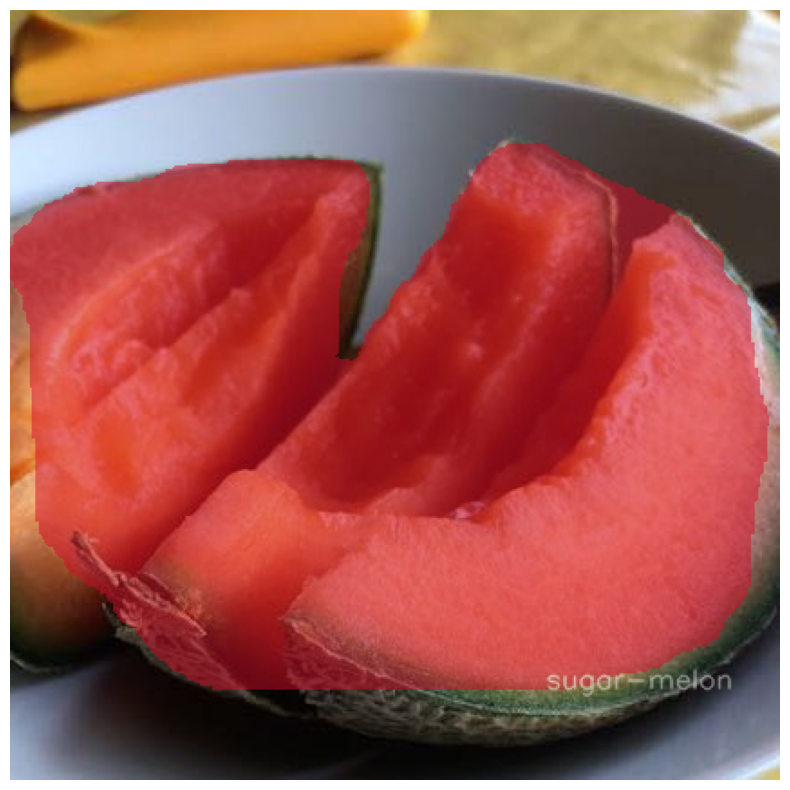

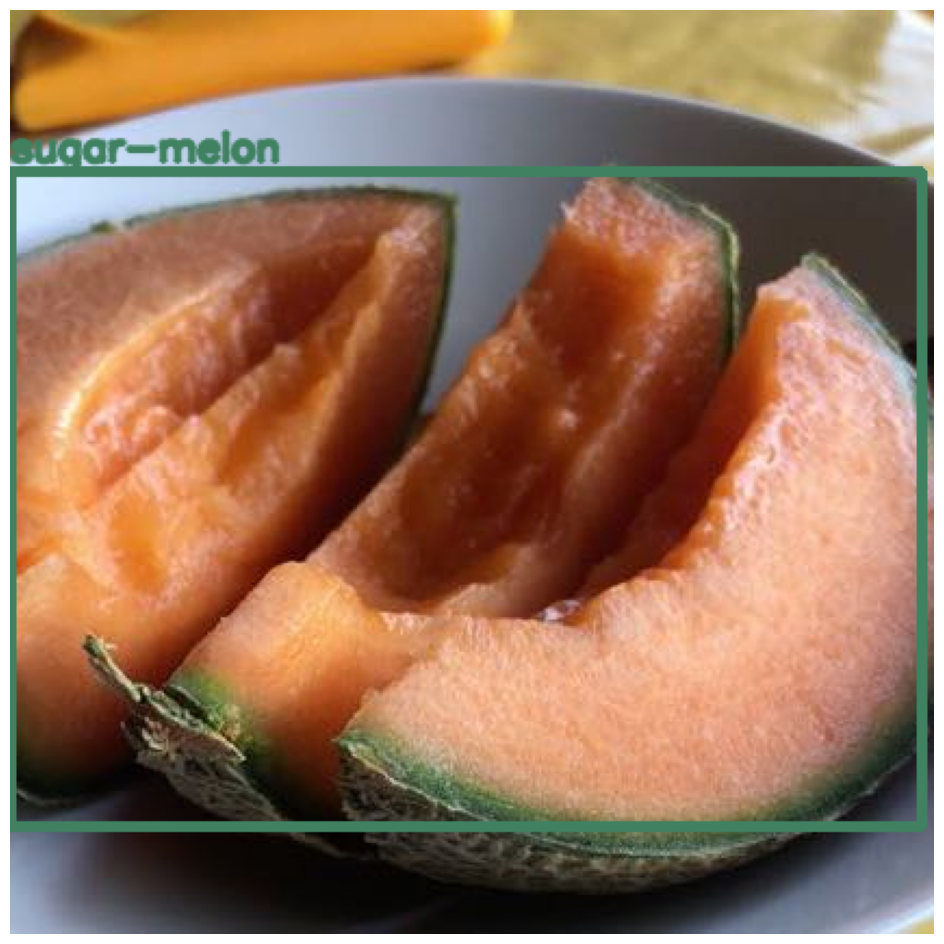

In [ ]:
import json

with open("final_classes.json", "r") as f:
    final_classes = json.load(f)

final_classes = {int(k): v for k, v in final_classes.items()}
image_path = "dataset/train/images/006331.jpg"
label_seg_path = "dataset/train/labels/006331.txt"
label_det_path = "dataset/train/labels_det/006331.txt"
visualize_yolo_seg(image_path, label_seg_path, final_classes)
visualize_yolo_det(image_path, label_det_path, final_classes)


## VAL PREP

In [12]:
ann_folder = "dataset/val/ann"
labels_folder = "dataset/val/labels_seg"
create_yolo_seg_labels(ann_folder, labels_folder, final_classes)
ann_folder = "dataset/val/ann"
labels_det_folder = "dataset/val/labels_det"
create_detection_labels_from_masks(ann_folder, labels_det_folder, final_classes)

YOLO detection labels created in: dataset/val/labels_det


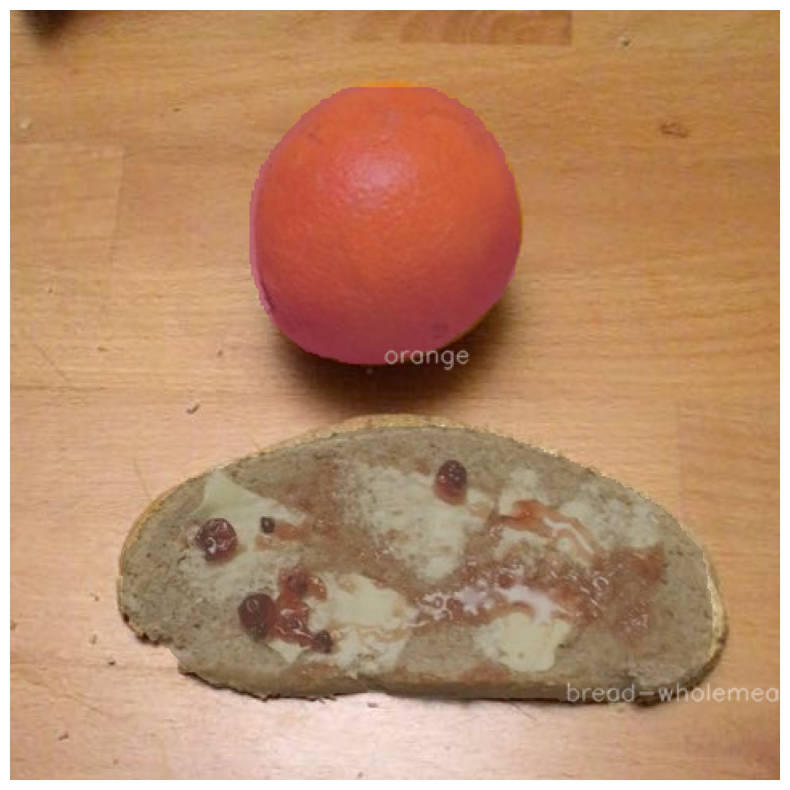

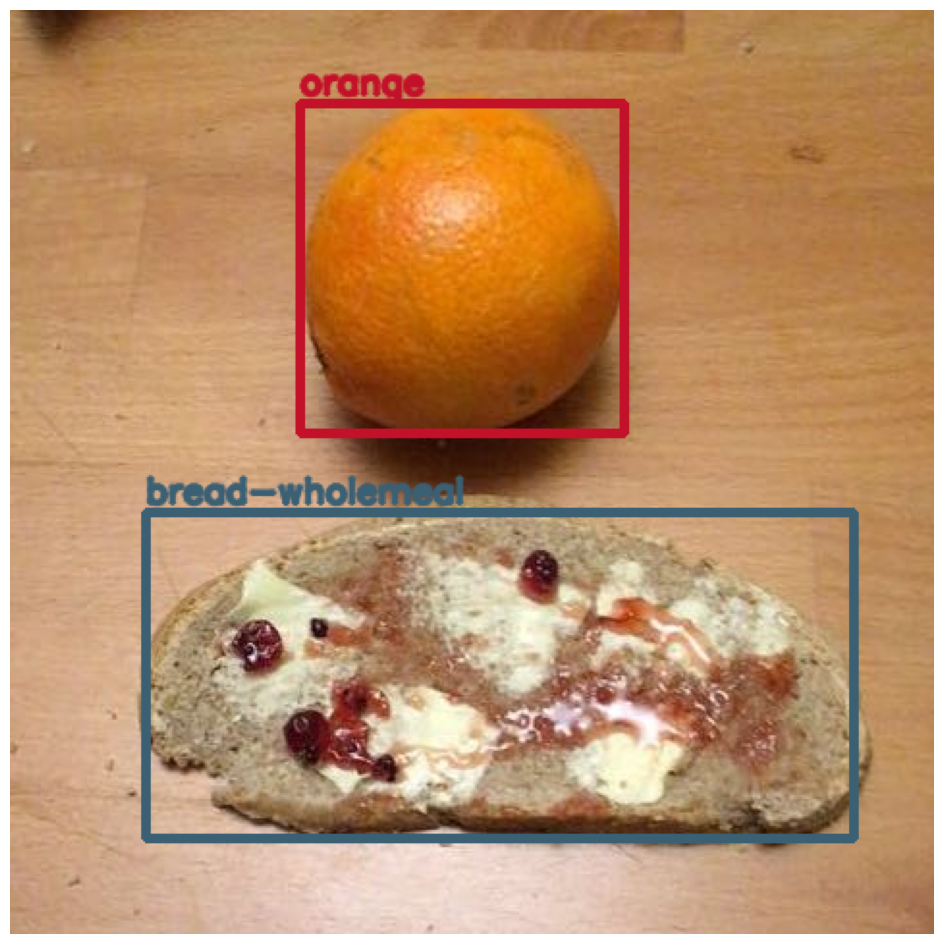

In [13]:
image_path = "dataset/val/images/010799.jpg"
label_seg_path = "dataset/val/labels_seg/010799.txt"
label_det_path = "dataset/val/labels_det/010799.txt"
visualize_yolo_seg(image_path, label_seg_path, final_classes)
visualize_yolo_det(image_path, label_det_path, final_classes)

## IMAGES FOLDER PREP

In [ ]:
## move images from images to homeless_images folder if not present in labels_det folder
import shutil
import os
# image_folder = "dataset/train/images"
# homeless_folder = "dataset/train/homeless_images"
# labels_det_folder = "dataset/train/labels_det" 
image_folder = "dataset/val/images"
homeless_folder = "dataset/val/homeless_images"
labels_det_folder = "dataset/val/labels_det" 
os.makedirs(homeless_folder, exist_ok=True)

for img_file in os.listdir(image_folder):
    if not img_file.endswith(".jpg"):
        continue

    label_det_file = os.path.join(labels_det_folder, img_file.replace(".jpg", ".txt"))
    if not os.path.exists(label_det_file):
        shutil.move(os.path.join(image_folder, img_file), homeless_folder)

## yolo det yaml creation

In [ ]:
import json

with open("final_classes.json", "r", encoding="utf-8") as f:
    final_classes = json.load(f)

sorted_classes = [final_classes[k] for k in sorted(final_classes, key=int)]

yaml_content = f"""# YOLO detection dataset
train: dataset/train/images
val: dataset/val/images

nc: {len(sorted_classes)}
names:
"""
for name in sorted_classes:
    yaml_content += f"  - {name}\n"

with open("dataset/yolo_det.yaml", "w", encoding="utf-8") as f:
    f.write(yaml_content)

print("YOLO detection YAML created with", len(sorted_classes), "classes.")


YOLO detection YAML created with 115 classes.


In [ ]:
import yaml

yaml_path = "dataset/yolo_det.yaml"

with open(yaml_path, "r", encoding="utf-8") as f:
    yolo_yaml = yaml.safe_load(f)

yaml_class_names = yolo_yaml["names"]

name_to_old_id = {v: int(k) for k, v in final_classes.items()} 
new_id_to_name = {}

for new_id, name in enumerate(yaml_class_names):
    old_id = name_to_old_id[name]
    old_to_new_id[old_id] = new_id
    new_id_to_name[new_id] = name

print("Old ID -> New ID mapping:")
print(old_to_new_id)

print("\nNew ID -> Name mapping:")
print(new_id_to_name)

with open('detect_classes.json', 'w', encoding='utf-8') as f:
    json.dump(new_id_to_name, f, ensure_ascii=False, indent=4)


Old ID -> New ID mapping:
{3415: 0, 3421: 1, 3423: 2, 3425: 3, 3427: 4, 3429: 5, 3431: 6, 3433: 7, 3443: 8, 3445: 9, 3447: 10, 3451: 11, 3453: 12, 3455: 13, 3461: 14, 3463: 15, 3469: 16, 3471: 17, 3473: 18, 3483: 19, 3485: 20, 3491: 21, 3493: 22, 3495: 23, 3497: 24, 3501: 25, 3503: 26, 3505: 27, 3527: 28, 3529: 29, 3531: 30, 3533: 31, 3535: 32, 3543: 33, 3551: 34, 3553: 35, 3555: 36, 3557: 37, 3563: 38, 3575: 39, 3581: 40, 3583: 41, 3589: 42, 3591: 43, 3593: 44, 3613: 45, 3615: 46, 3617: 47, 3633: 48, 3643: 49, 3647: 50, 3649: 51, 3651: 52, 3661: 53, 3663: 54, 3669: 55, 3671: 56, 3675: 57, 3699: 58, 3713: 59, 3719: 60, 3731: 61, 3733: 62, 3739: 63, 3779: 64, 3797: 65, 3813: 66, 3819: 67, 3837: 68, 3873: 69, 3879: 70, 3885: 71, 3891: 72, 3899: 73, 3925: 74, 3941: 75, 3957: 76, 3973: 77, 3983: 78, 3991: 79, 3993: 80, 3995: 81, 3997: 82, 4001: 83, 4011: 84, 4013: 85, 4015: 86, 4017: 87, 4021: 88, 4041: 89, 4059: 90, 4063: 91, 4077: 92, 4083: 93, 4097: 94, 4099: 95, 4103: 96, 4131: 97, 414

## remaping class ids for detection labels

In [ ]:
import os

labels_det_folders = ["dataset/train/labels_det", "dataset/val/labels_det"]


for folder in labels_det_folders:
    for txt_file in os.listdir(folder):
        if not txt_file.endswith(".txt"):
            continue
        
        file_path = os.path.join(folder, txt_file)
        new_lines = []
        
        with open(file_path, "r", encoding="utf-8") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                
                old_id = int(parts[0])
                if old_id not in old_to_new_id:
                    continue  
                
                new_id = old_to_new_id[old_id]
                new_line = f"{new_id} {' '.join(parts[1:])}"
                new_lines.append(new_line)
        
        # Overwrite the file with new IDs
        with open(file_path, "w", encoding="utf-8") as f:
            f.write("\n".join(new_lines))

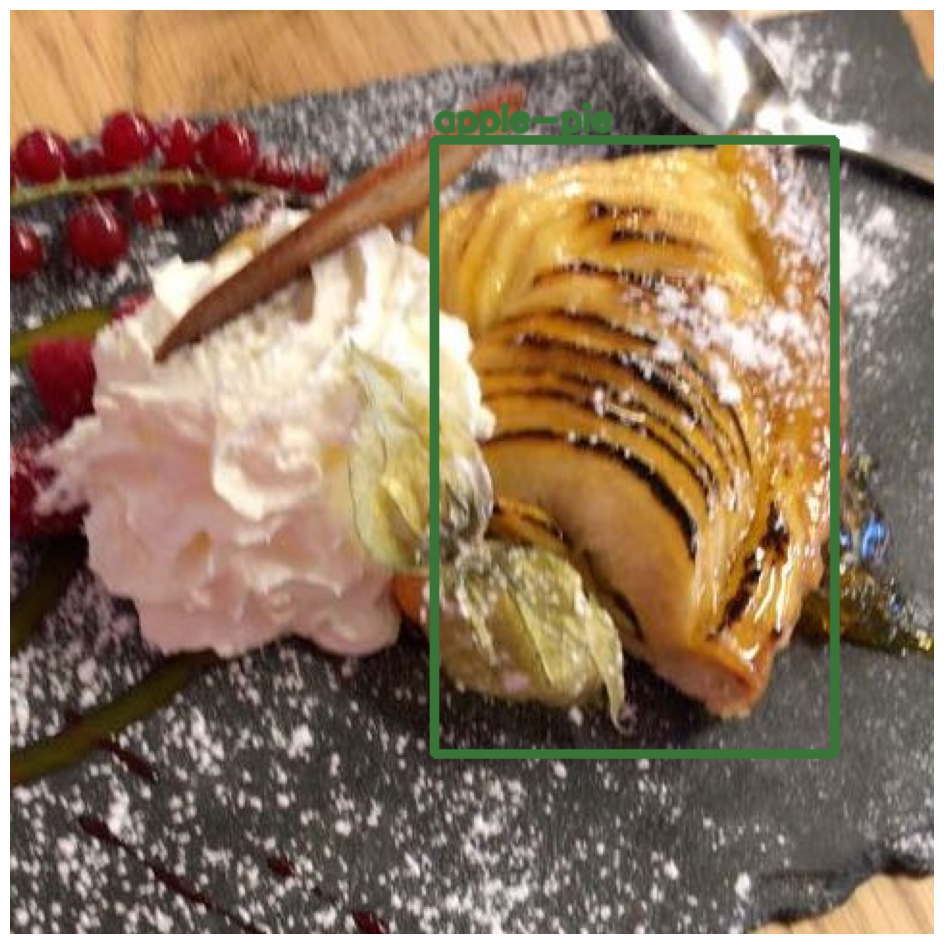

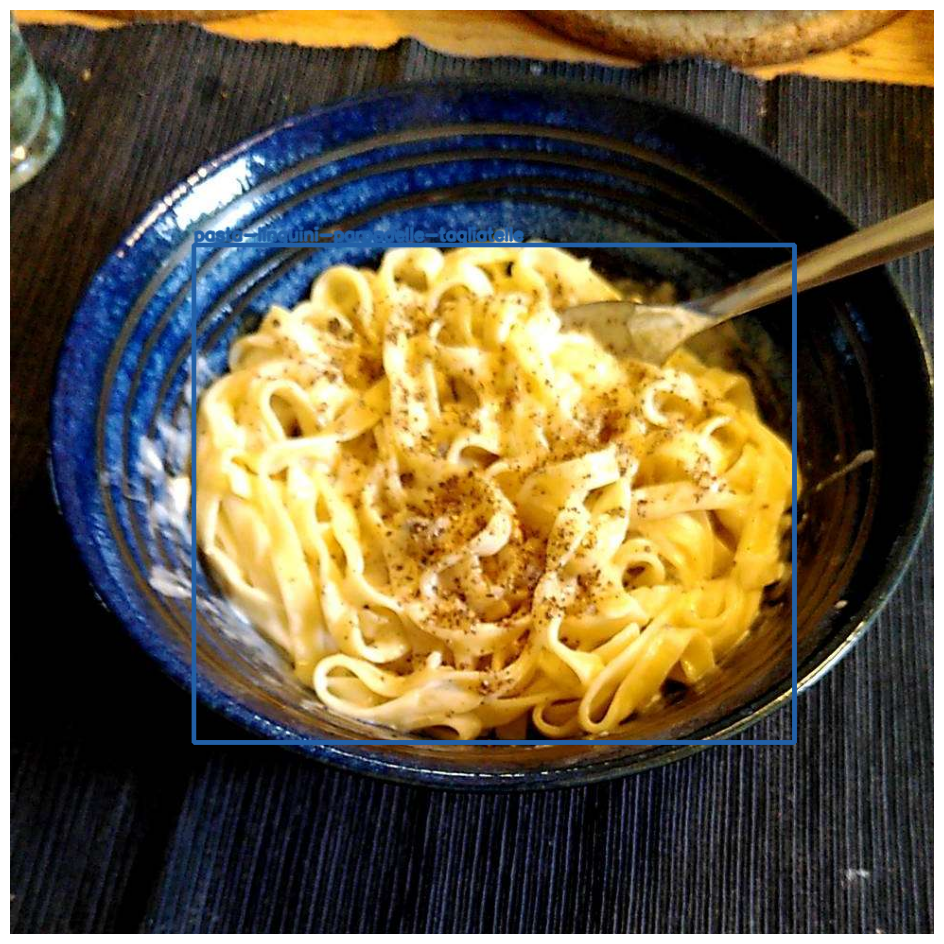

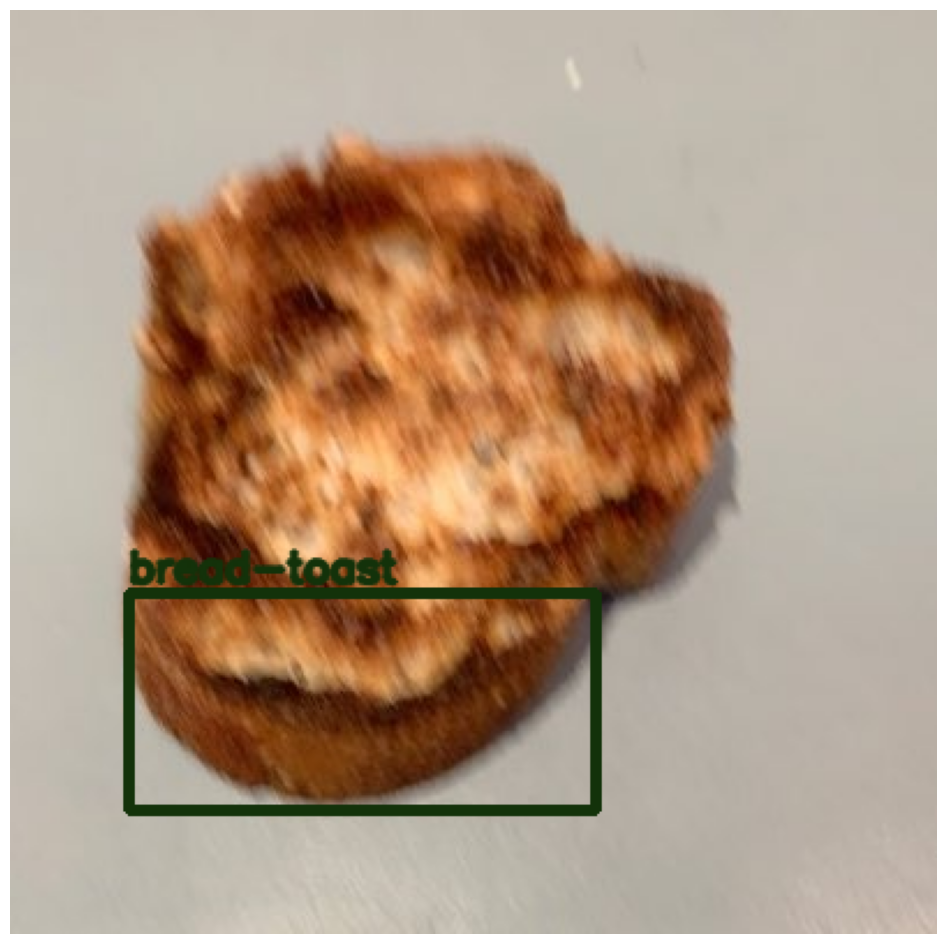

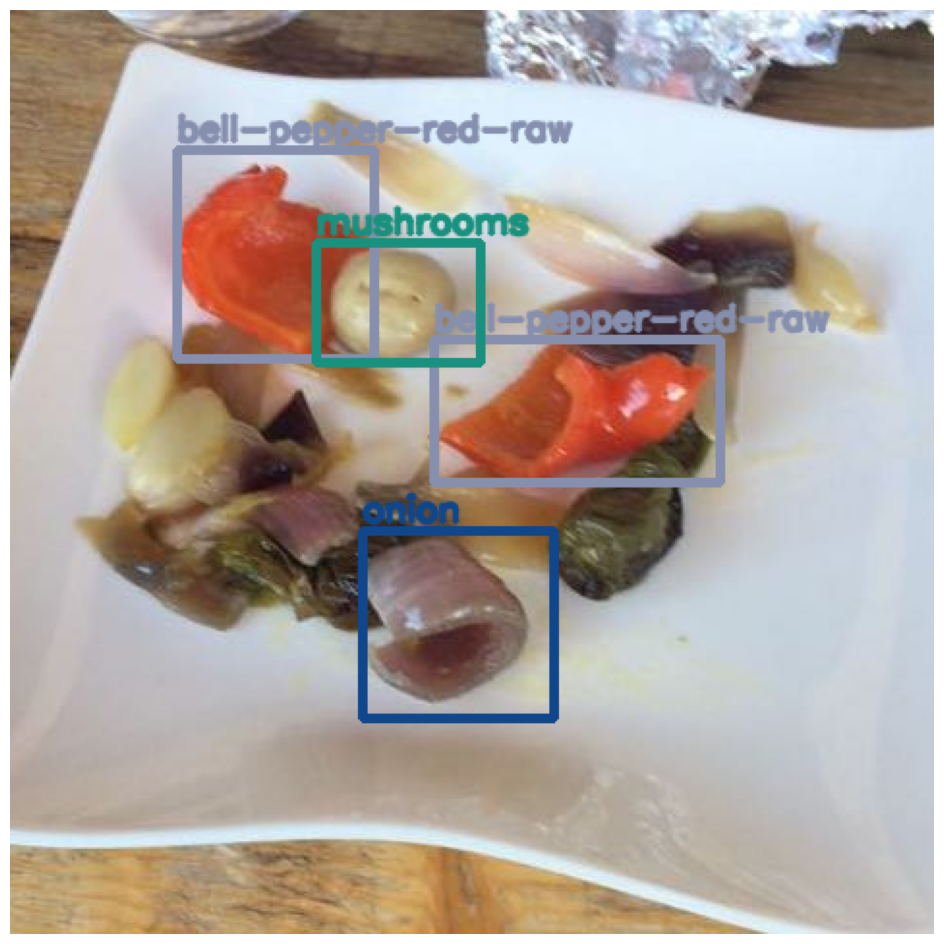

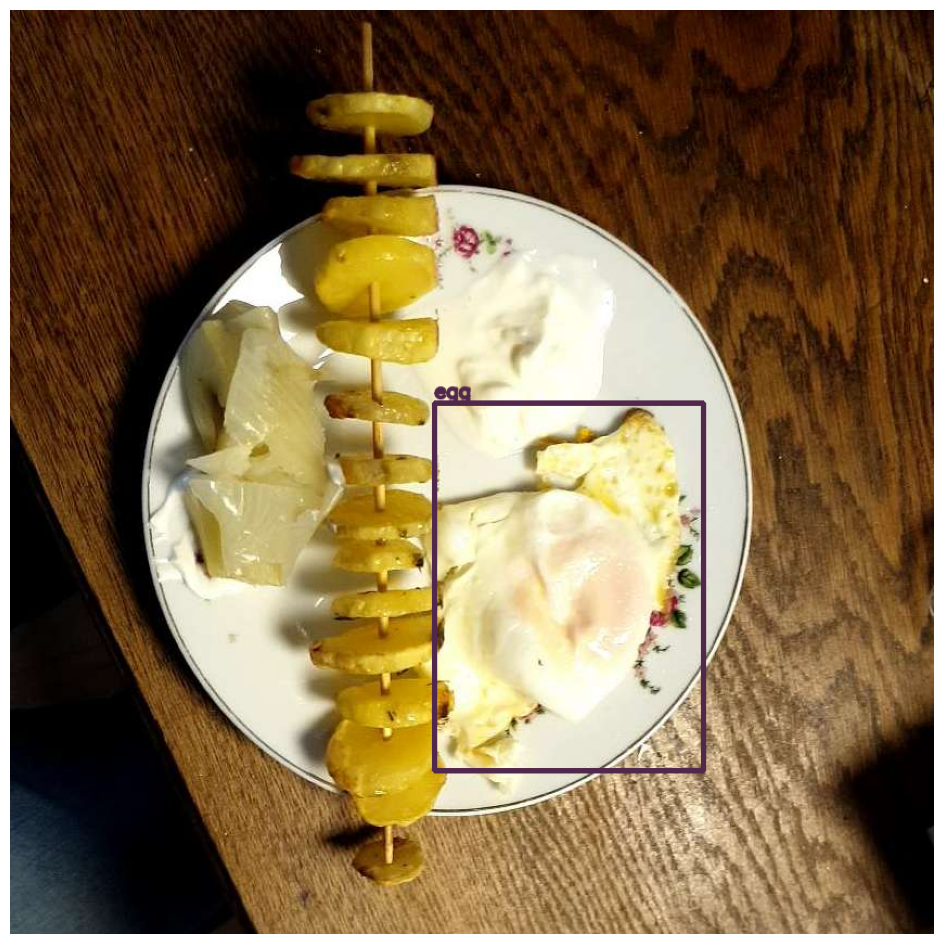

In [ ]:
import json

with open("detect_classes.json", "r") as f:
    classes = json.load(f)

classes = {int(k): v for k, v in classes.items()}
# image_path = "dataset/train/images/006331.jpg"
# label_det_path = "dataset/train/labels_det/006331.txt"
# visualize_yolo_det(image_path, label_det_path, classes)
images_dir = "dataset/train/images"
for i in range(5):
    img_filename = random.choice(os.listdir(images_dir))
    if not img_filename.endswith(".jpg"):
        continue
    img_path = os.path.join(images_dir, img_filename)
    label_det_path = os.path.join("dataset/train/labels_det", img_filename.replace(".jpg", ".txt"))
    visualize_yolo_det(img_path, label_det_path, classes)

# Data augmentation

In [ ]:
import os
import json
import cv2
import albumentations as A
from shutil import copy2
from random import randint
from collections import Counter

train_img_dir = r"dataset/train/images"
train_label_dir = r"dataset/train/labels"
aug_img_dir = r"dataset/aug/images"
aug_label_dir = r"dataset/aug/labels"

os.makedirs(aug_img_dir, exist_ok=True)
os.makedirs(aug_label_dir, exist_ok=True)

with open("detect_classes.json", "r") as f:
    class_dict = json.load(f)

def count_classes(label_dir):
    counter = Counter()
    for file in os.listdir(label_dir):
        if file.endswith(".txt"):
            with open(os.path.join(label_dir, file), "r") as f:
                for line in f:
                    cls_id = int(line.split()[0])
                    counter[cls_id] += 1
    return counter

train_counts = count_classes(train_label_dir)

# Parameters
min_count = 500  # Minimum target per class

# Augmentation pipeline
transform = A.Compose([
    A.HorizontalFlip(p=1),
    A.VerticalFlip(p=1),
    A.RandomBrightnessContrast(p=0.5)
])

def flip_bboxes_yolo(bboxes, horizontal=False, vertical=False):
    new_bboxes = []
    for bbox in bboxes:
        x_center, y_center, w, h = bbox
        if horizontal:
            x_center = 1 - x_center
        if vertical:
            y_center = 1 - y_center
        new_bboxes.append([x_center, y_center, w, h])
    return new_bboxes

# Loop through images
for img_file in os.listdir(train_img_dir):
    if not img_file.endswith((".jpg", ".png")):
        continue

    img_path = os.path.join(train_img_dir, img_file)
    label_file = os.path.splitext(img_file)[0] + ".txt"
    label_path = os.path.join(train_label_dir, label_file)

    if not os.path.exists(label_path):
        print(f"Skipping {img_file}, no label found.")
        continue

    bboxes = []
    class_labels = []
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            cls_id = int(parts[0])
            bbox = list(map(float, parts[1:5]))  
            bboxes.append(bbox)
            class_labels.append(cls_id)

    underrep_classes = [cls for cls in set(class_labels) if train_counts.get(cls,0) < min_count]
    if not underrep_classes:
        continue

    img = cv2.imread(img_path)
    h, w = img.shape[:2]

    # Horizontal flip
    img_hflip = cv2.flip(img, 1)
    bboxes_hflip = flip_bboxes_yolo(bboxes, horizontal=True)
    new_img_file = os.path.splitext(img_file)[0] + f"_hflip.jpg"
    cv2.imwrite(os.path.join(aug_img_dir, new_img_file), img_hflip)
    with open(os.path.join(aug_label_dir, os.path.splitext(new_img_file)[0]+".txt"), "w") as f:
        for cls, bb in zip(class_labels, bboxes_hflip):
            f.write(f"{cls} {bb[0]} {bb[1]} {bb[2]} {bb[3]}\n")

    # Vertical flip
    img_vflip = cv2.flip(img, 0)
    bboxes_vflip = flip_bboxes_yolo(bboxes, vertical=True)
    new_img_file = os.path.splitext(img_file)[0] + f"_vflip.jpg"
    cv2.imwrite(os.path.join(aug_img_dir, new_img_file), img_vflip)
    with open(os.path.join(aug_label_dir, os.path.splitext(new_img_file)[0]+".txt"), "w") as f:
        for cls, bb in zip(class_labels, bboxes_vflip):
            f.write(f"{cls} {bb[0]} {bb[1]} {bb[2]} {bb[3]}\n")

    for cls in underrep_classes:
        train_counts[cls] += 2  

print("Augmentation done.")

Skipping 178750.jpg.png, no label found.
Skipping 178868.jpg.png, no label found.
Skipping 178893.jpg.png, no label found.
Skipping 179197.jpg.png, no label found.
Skipping 179199.jpg.png, no label found.
Skipping 179266.jpg.png, no label found.
Skipping 179269.jpg.png, no label found.
Skipping 179873.jpg.png, no label found.
Skipping 180227.jpg.png, no label found.
Skipping 180329.jpg.png, no label found.
Skipping 181019.jpg.png, no label found.
Skipping 181020.jpg.png, no label found.
Skipping 181558.jpg.png, no label found.
Skipping 183088.jpg.png, no label found.
Skipping 183336.jpg.png, no label found.
Skipping 183647.jpg.png, no label found.
Skipping 183940.jpg.png, no label found.
Skipping 184005.jpg.png, no label found.
Augmentation done.


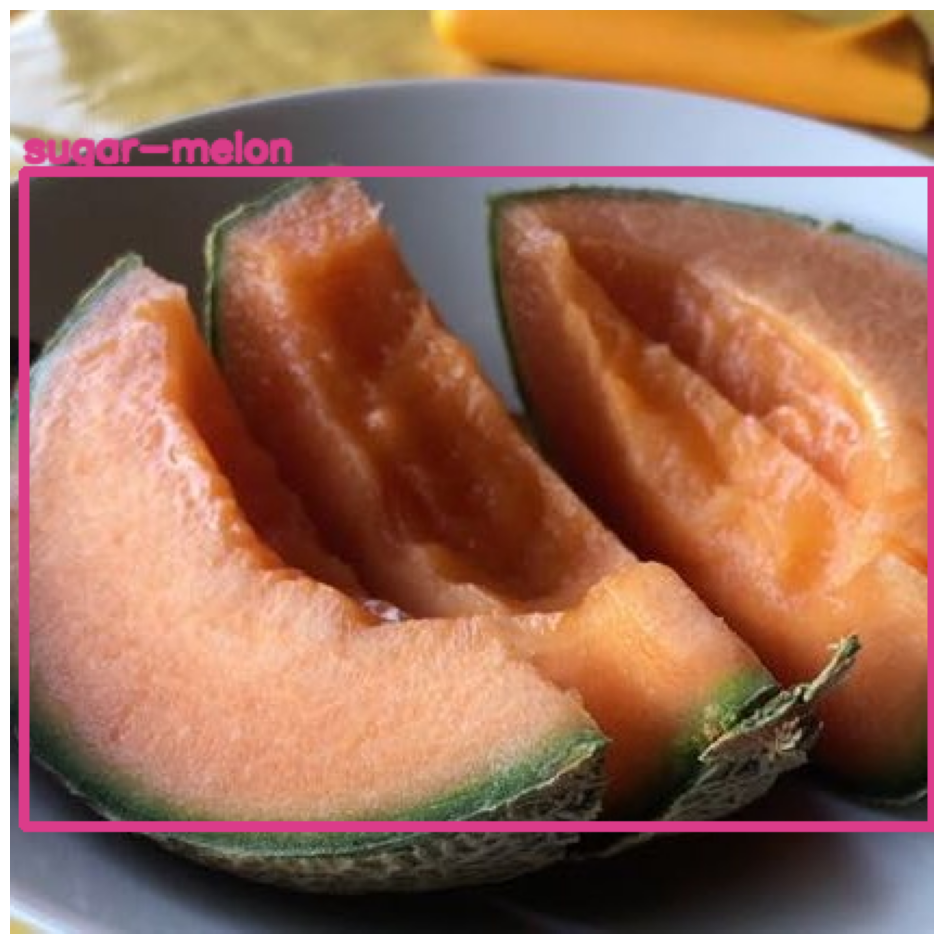

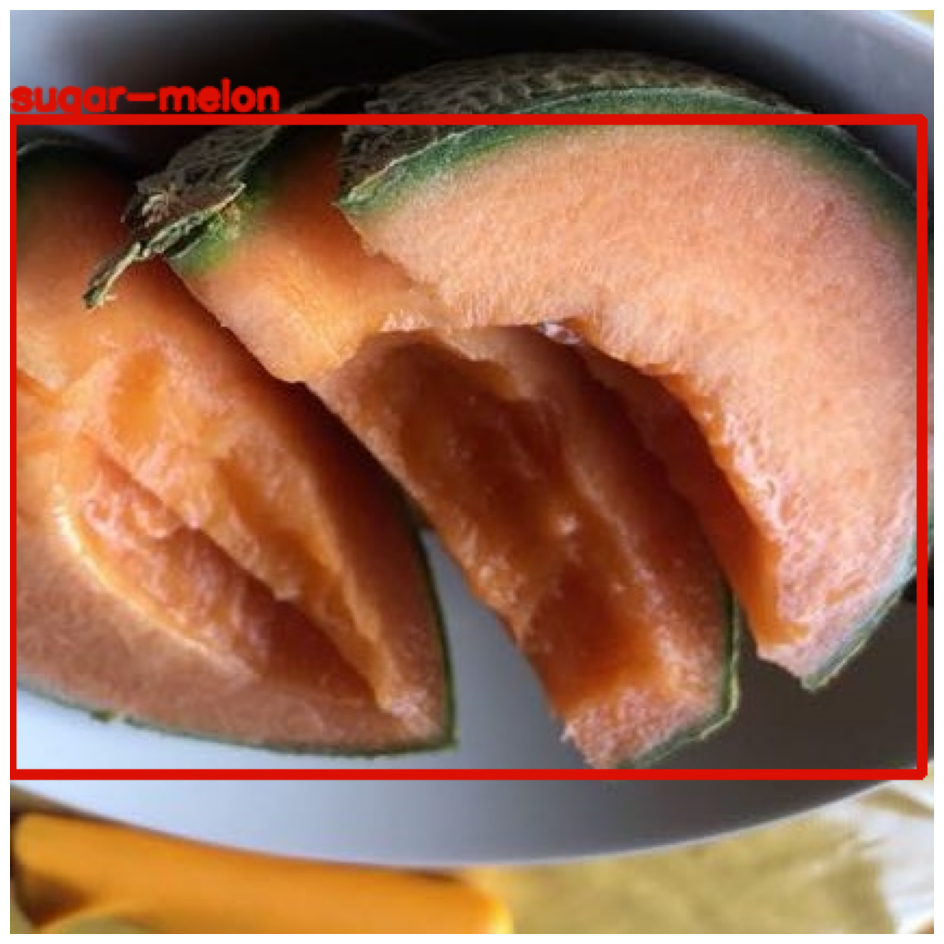

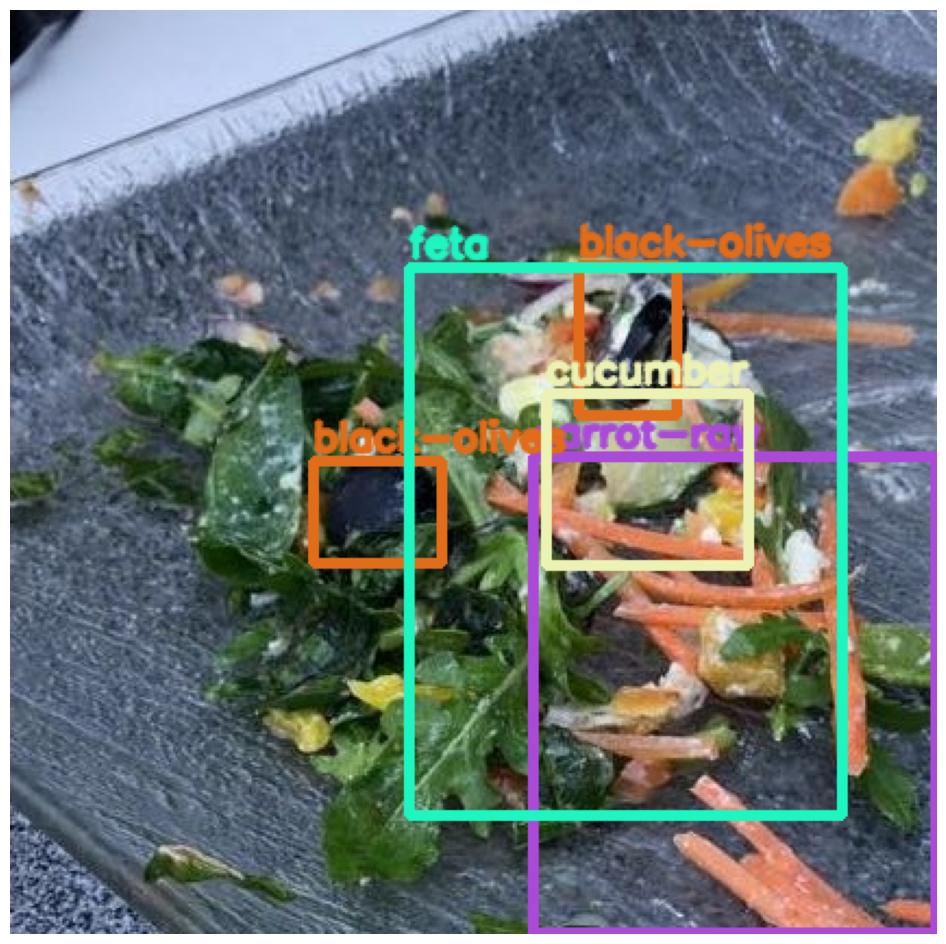

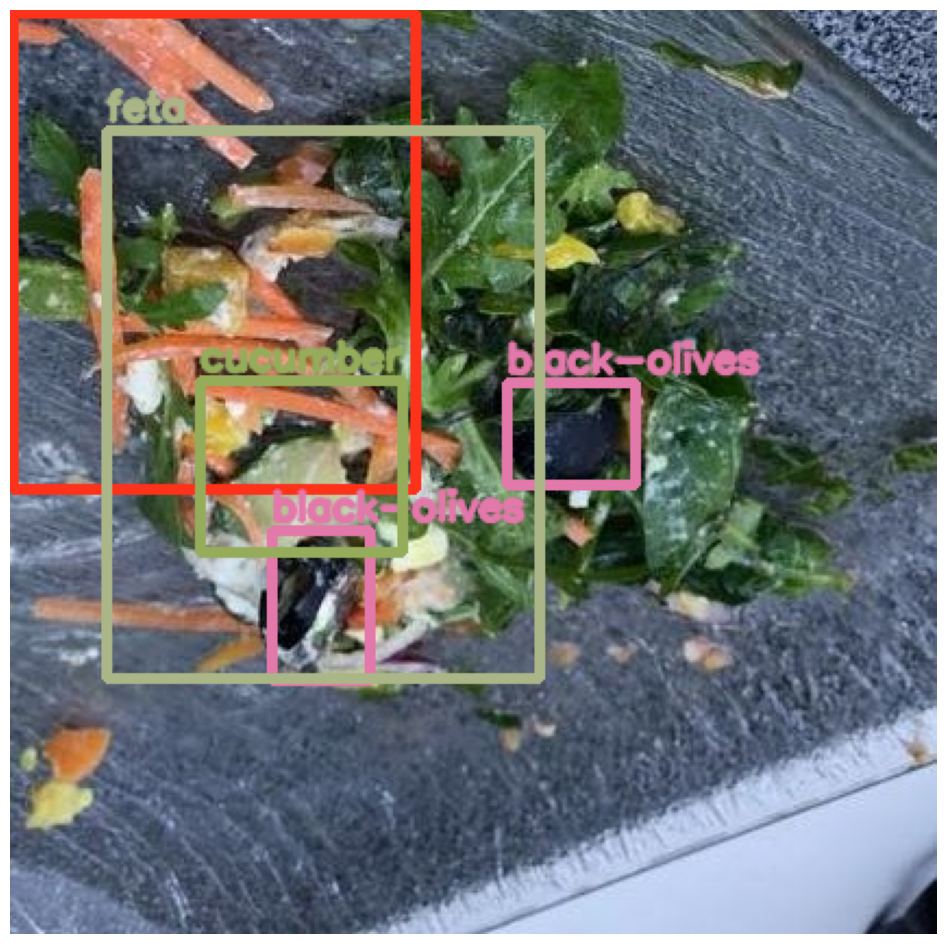

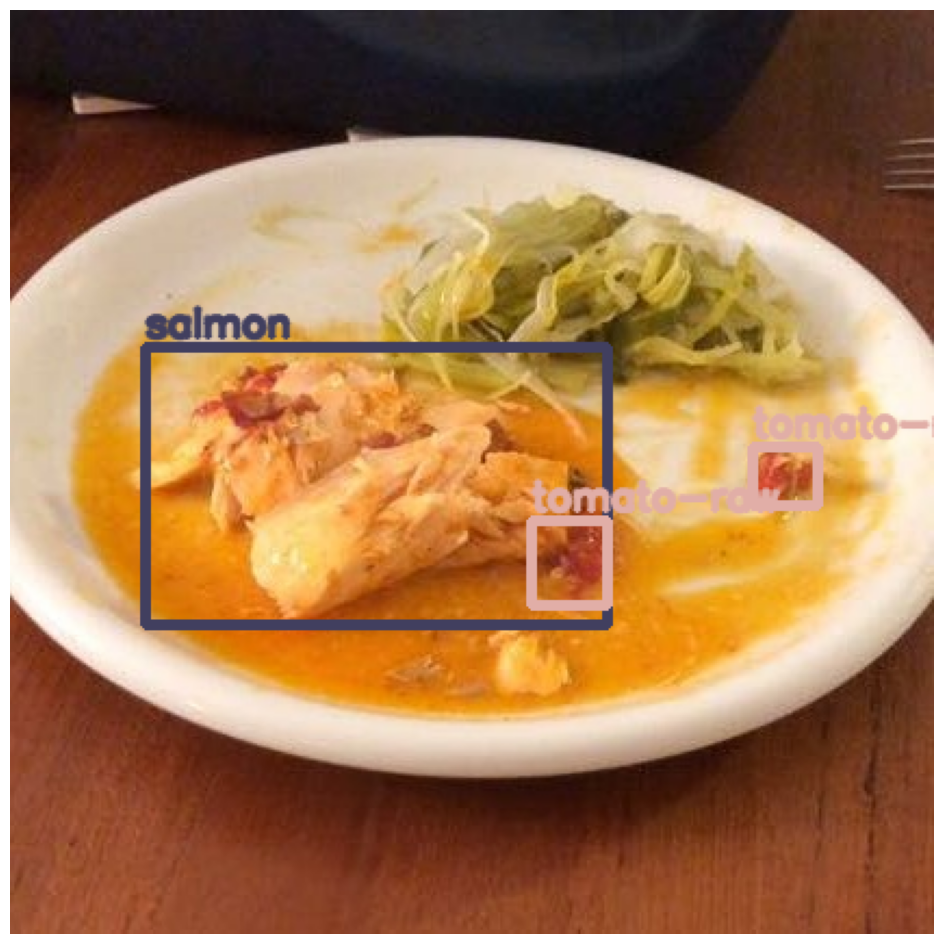

In [ ]:
import json
import random

with open("detect_classes.json", "r") as f:
    classes = json.load(f)

classes = {int(k): v for k, v in classes.items()}
# image_path = "dataset/train/images/006331.jpg"
# label_det_path = "dataset/train/labels_det/006331.txt"
# visualize_yolo_det(image_path, label_det_path, classes)
images_dir = "dataset/aug/images"
files = [f for f in sorted(os.listdir(images_dir)) if f.lower().endswith(".jpg")]
for img_filename in files[:5]:
    img_path = os.path.join(images_dir, img_filename)
    label_det_path = os.path.join("dataset/aug/labels", os.path.splitext(img_filename)[0] + ".txt")
    visualize_yolo_det(img_path, label_det_path, classes)


### Another merging of classes

In [3]:
train_dir = "dataset/train/images"
train_dir_labels = "dataset/train/labels"
val_dir = "dataset/val/images"
val_dir_labels = "dataset/val/labels"

## move all val to train
for file in os.listdir(val_dir):
    src_path = os.path.join(val_dir, file)
    dst_path = os.path.join(train_dir, file)
    os.rename(src_path, dst_path)
for file in os.listdir(val_dir_labels):
    src_path = os.path.join(val_dir_labels, file)
    dst_path = os.path.join(train_dir_labels, file)
    os.rename(src_path, dst_path)


### merging some redundant classes to reduce complexity

In [ ]:
import os
import json
from tqdm import tqdm

with open("detect_classes.json", "r") as f:
    class_map = json.load(f)

id2cls = {int(k): v for k, v in class_map.items()}
cls2id = {v: int(k) for k, v in class_map.items()}

merge_groups = {
    "green-bean-steamed-without-addition-of-salt": "green-beans",
    "french-beans": "green-beans",
    "carrot-steamed-without-addition-of-salt": "carrot",
    "carrot-raw": "carrot",
    "ham": "ham",
    "ham-cooked": "ham",
    "salmon-smoked": "salmon",
    "salmon": "salmon",
    "birchermuesli-prepared-no-sugar-added": "muesli",
    "muesli": "muesli",
}

for cls in id2cls.values():
    if any(p in cls for p in ["pasta", "spaghetti", "noodles", "penne", "linguini", "tagliatelle", "parpadelle", "twist"]):
        merge_groups[cls] = "pasta"

merged_name = {cls: merge_groups.get(cls, cls) for cls in id2cls.values()}

merged_classes = sorted(set(merged_name.values()))

new_cls2id = {cls: i for i, cls in enumerate(merged_classes)}
old_to_new = {cls2id[old_cls]: new_cls2id[new_cls] for old_cls, new_cls in merged_name.items()}

with open("detect_classes_v2.json", "w") as f:
    json.dump(new_cls2id, f, indent=4)
print("✅ Saved detect_classes_v2.json")

def update_labels_in_dir(label_dir):
    for file in tqdm(os.listdir(label_dir), desc=f"Updating {label_dir}"):
        if not file.endswith(".txt"):
            continue
        path = os.path.join(label_dir, file)
        with open(path, "r") as f:
            lines = f.readlines()

        new_lines = []
        for line in lines:
            parts = line.strip().split()
            if not parts:
                continue
            old_id = int(parts[0])
            if old_id in old_to_new:
                parts[0] = str(old_to_new[old_id])
                new_lines.append(" ".join(parts))

        with open(path, "w") as f:
            f.write("\n".join(new_lines) + "\n")

✅ Saved detect_classes_v2.json


In [6]:
update_labels_in_dir("dataset/train/labels")

print("✅ All label IDs updated according to new mapping")

yaml_path = "dataset/yolo_det_v2.yaml"
with open(yaml_path, "w") as f:
    f.write(f"path: dataset\n")
    f.write(f"train: train/images\n")
    f.write(f"val: val/images\n")
    f.write(f"nc: {len(merged_classes)}\n")
    f.write("names:\n")
    for i, cls in enumerate(merged_classes):
        f.write(f"  {i}: {cls}\n")

print(f"✅ Saved updated YAML: {yaml_path}")
print(f"✅ New class count: {len(merged_classes)}")

Updating dataset/train/labels: 100%|██████████| 38226/38226 [00:32<00:00, 1177.44it/s]

✅ All label IDs updated according to new mapping
✅ Saved updated YAML: dataset/yolo_det_v2.yaml
✅ New class count: 105


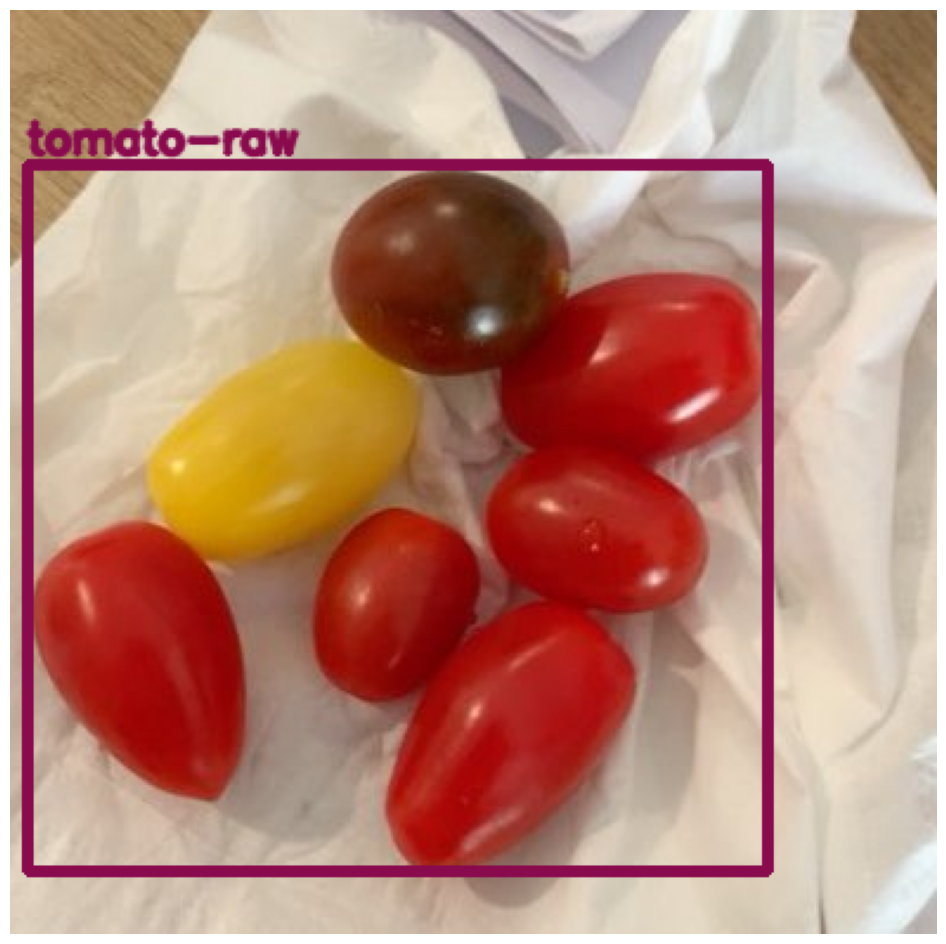

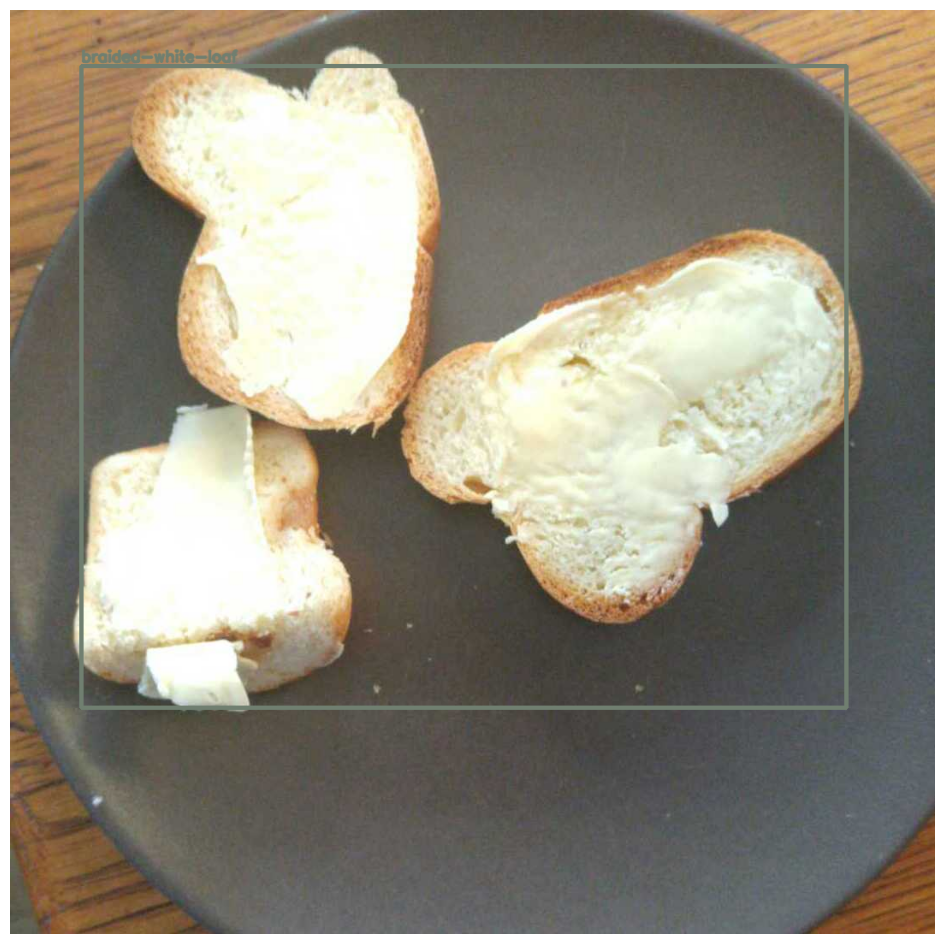

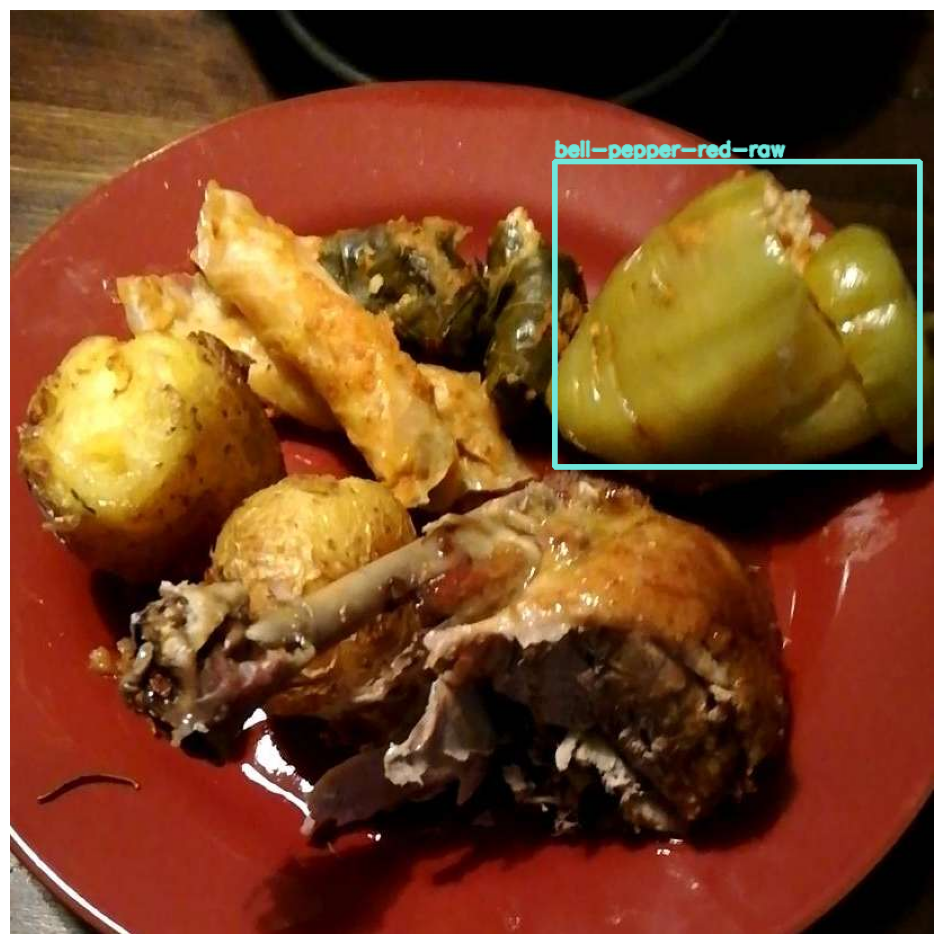

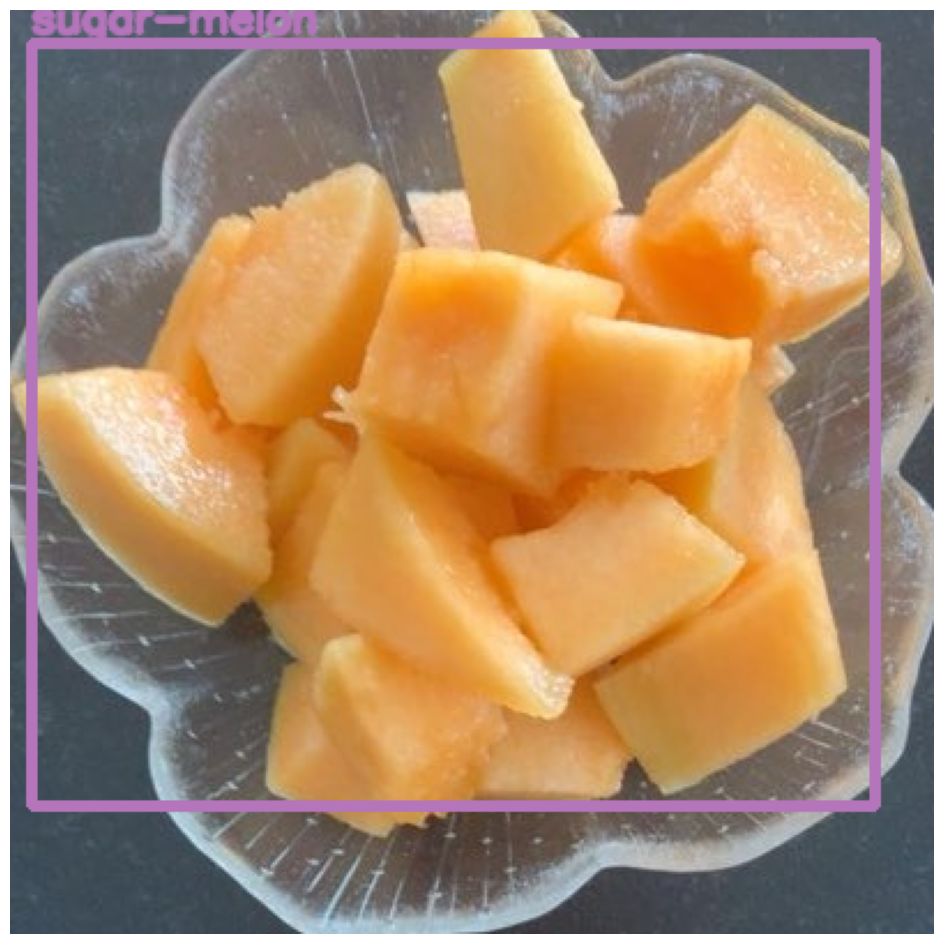

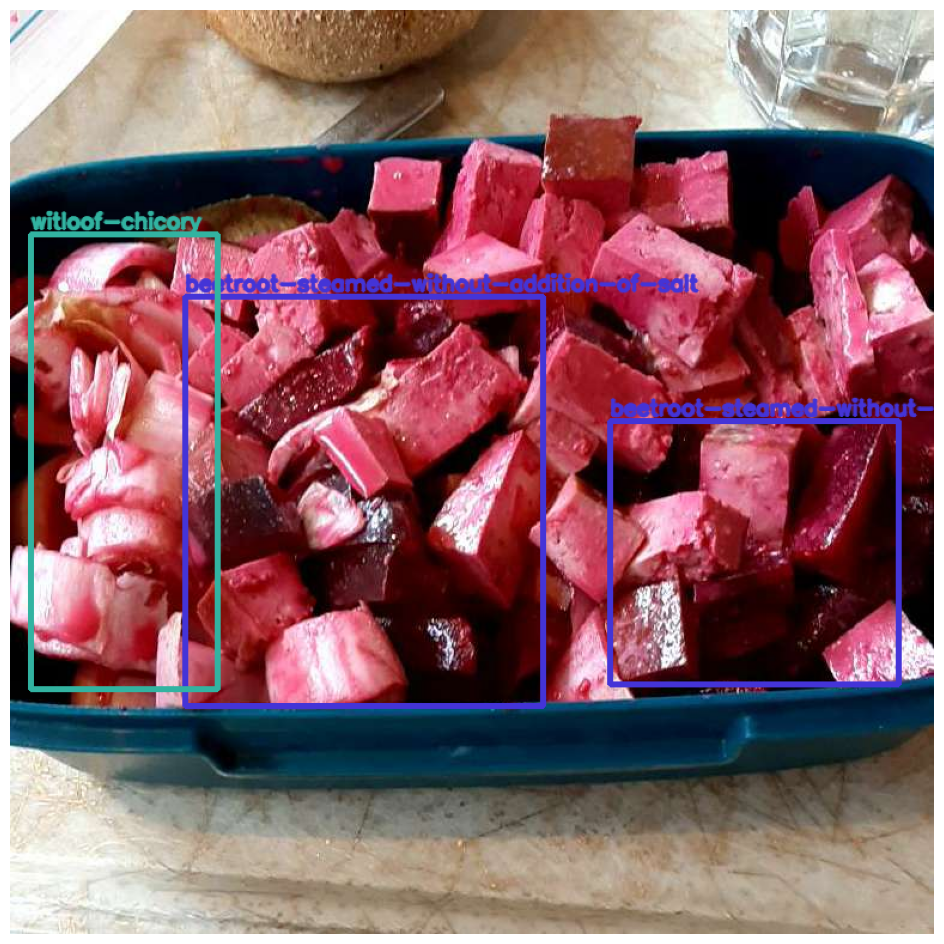

In [ ]:
import json
import random

with open("detect_classes_v2.json", "r") as f:
    classes = json.load(f)

classes = {int(k): v for k, v in classes.items()}
# image_path = "dataset/train/images/006331.jpg"
# label_det_path = "dataset/train/labels_det/006331.txt"
# visualize_yolo_det(image_path, label_det_path, classes)
images_dir = "dataset/train/images"
files = [f for f in os.listdir(images_dir) if f.lower().endswith(".jpg")]
if not files:
    print("No images found in", images_dir)
else:
    sampled = random.sample(files, k=min(5, len(files)))
    for img_filename in sampled:
        img_path = os.path.join(images_dir, img_filename)
        label_det_path = os.path.join("dataset/train/labels", os.path.splitext(img_filename)[0] + ".txt")
        visualize_yolo_det(img_path, label_det_path, classes)


## Add classes from second dataset (Food103)

In [ ]:
import os
import json
import base64
import io
import zlib
import numpy as np
from PIL import Image

def create_detection_labels_from_bitmaps_zlib(
    ann_folder,
    labels_det_folder,
    meta_path,
    final_classes=None,
    new_class_id=None
):
    """
    Converts bitmap masks (SuperAnnotate JSON format) to YOLO detection labels (.txt),
    supporting zlib-compressed bitmaps and flexible class remapping.
    """
    os.makedirs(labels_det_folder, exist_ok=True)

    with open(meta_path, "r", encoding="utf-8") as f:
        meta = json.load(f)

    id_to_idx = {}
    idx_to_name = {0: "background"}
    for i, cls in enumerate(meta["classes"], start=1):
        id_to_idx[cls["id"]] = i
        idx_to_name[i] = cls["title"]

    print(f"Loaded {len(id_to_idx)} classes from meta.json")

    class_remap = {}
    if isinstance(final_classes, list) and isinstance(new_class_id, list):
        if len(final_classes) != len(new_class_id):
            raise ValueError("`final_classes` and `new_class_id` must have the same length.")
        class_remap = dict(zip(final_classes, new_class_id))

    def decode_bitmap_zlib(bitmap_dict):
        """Decode zlib+base64 compressed bitmap mask."""
        try:
            bmp_data = base64.b64decode(bitmap_dict["data"])
            try:
                decompressed = zlib.decompress(bmp_data)
            except Exception:
                decompressed = bmp_data  
            bmp_img = Image.open(io.BytesIO(decompressed)).convert("L")
            bmp_mask = np.array(bmp_img) > 0
            return bmp_mask
        except Exception as e:
            print(f"ailed to decode bitmap: {e}")
            return None

    for ann_file in os.listdir(ann_folder):
        if not ann_file.endswith(".json"):
            continue

        ann_path = os.path.join(ann_folder, ann_file)
        with open(ann_path, "r", encoding="utf-8") as f:
            ann = json.load(f)

        img_h, img_w = ann["size"]["height"], ann["size"]["width"]
        yolo_lines = []

        for obj in ann.get("objects", []):
            if "bitmap" not in obj:
                continue

            cls_id = id_to_idx.get(obj["classId"])
            if cls_id is None:
                continue

            if final_classes and obj["classId"] not in final_classes:
                continue

            bitmap = obj["bitmap"]
            bmp_mask = decode_bitmap_zlib(bitmap)
            if bmp_mask is None:
                continue

            origin_x, origin_y = bitmap["origin"]
            ys, xs = np.where(bmp_mask)
            if len(xs) == 0 or len(ys) == 0:
                continue

            x_min = origin_x + xs.min()
            x_max = origin_x + xs.max()
            y_min = origin_y + ys.min()
            y_max = origin_y + ys.max()

            # Normalize for YOLOv11 format
            x_center = ((x_min + x_max) / 2) / img_w
            y_center = ((y_min + y_max) / 2) / img_h
            w = (x_max - x_min) / img_w
            h = (y_max - y_min) / img_h

            if isinstance(new_class_id, int):
                yolo_cls = new_class_id
            elif isinstance(new_class_id, list) and obj["classId"] in class_remap:
                yolo_cls = class_remap[obj["classId"]]
            else:
                yolo_cls = cls_id  

            yolo_lines.append(f"{yolo_cls} {x_center:.6f} {y_center:.6f} {w:.6f} {h:.6f}")

        if not yolo_lines:
            continue

        out_name = ann_file.replace(".jpg.json", ".txt").replace(".json", ".txt")
        out_file = os.path.join(labels_det_folder, out_name)
        with open(out_file, "w", encoding="utf-8") as f:
            f.write("\n".join(yolo_lines))

    print(f"✅ YOLO detection labels created in: {labels_det_folder}")


In [ ]:
create_detection_labels_from_bitmaps_zlib(
    ann_folder="food103/train/ann",
    labels_det_folder="dataset/train/labels",
    meta_path="food103/meta.json",
    final_classes=[6539267, 6539308,   , 6539224],  
    new_class_id= [105, 106, 107, 108]         
)


Loaded 103 classes from meta.json
✅ YOLO detection labels created in: dataset/train/labels


In [ ]:
create_detection_labels_from_bitmaps_zlib(
    ann_folder="food103/train/ann",
    labels_det_folder="dataset/train/labels",
    meta_path="food103/meta.json",
    final_classes=[6539308],   
    new_class_id=106          
)


Loaded 103 classes from meta.json
✅ YOLO detection labels created in: dataset/train/labels


In [ ]:
for file in os.listdir("dataset/train/labels"):
    if file.endswith(".jpg.txt"):
        os.remove(os.path.join("dataset/train/labels", file))

In [ ]:
import os
import shutil

labels_dir = "dataset/train/labels"
images_src_dir = "food103/train/images"
images_dst_dir = "dataset/train/images"

copied = 0
missing = 0

for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue

    base_name = os.path.splitext(label_file)[0]  
    image_name = base_name + ".jpg"
    src_img_path = os.path.join(images_src_dir, image_name)
    dst_img_path = os.path.join(images_dst_dir, image_name)

    if os.path.exists(src_img_path):
        shutil.copy2(src_img_path, dst_img_path)
        copied += 1
    else:
        missing += 1
        print(f"⚠️ Missing image for label: {label_file}")

print(f"✅ Copied {copied} images to {images_dst_dir}")
if missing:
    print(f"⚠️ {missing} images were missing in {images_src_dir}")


⚠️ Missing image for label: 00000004.jpg.txt
⚠️ Missing image for label: 00000015.jpg.txt
⚠️ Missing image for label: 00000020.jpg.txt
⚠️ Missing image for label: 00000028.jpg.txt
⚠️ Missing image for label: 00000029.jpg.txt
⚠️ Missing image for label: 00000034.jpg.txt
⚠️ Missing image for label: 00000040.jpg.txt
⚠️ Missing image for label: 00000049.jpg.txt
⚠️ Missing image for label: 00000056.jpg.txt
⚠️ Missing image for label: 00000061.jpg.txt
⚠️ Missing image for label: 00000066.jpg.txt
⚠️ Missing image for label: 00000067.jpg.txt
⚠️ Missing image for label: 00000077.jpg.txt
⚠️ Missing image for label: 00000082.jpg.txt
⚠️ Missing image for label: 00000083.jpg.txt
⚠️ Missing image for label: 00000110.jpg.txt
⚠️ Missing image for label: 00000113.jpg.txt
⚠️ Missing image for label: 00000115.jpg.txt
⚠️ Missing image for label: 00000134.jpg.txt
⚠️ Missing image for label: 00000144.jpg.txt
⚠️ Missing image for label: 00000157.jpg.txt
⚠️ Missing image for label: 00000163.jpg.txt
⚠️ Missing

In [ ]:
create_detection_labels_from_bitmaps_zlib(
    ann_folder="food103/train/ann",
    labels_det_folder="dataset/train/labels",
    meta_path="food103/meta.json",
    final_classes=[6539262, 6539291],   
    new_class_id= [109, 110]           
)

Loaded 103 classes from meta.json
✅ YOLO detection labels created in: dataset/train/labels


In [ ]:
import os
import shutil

labels_dir = "dataset/train/labels"
images_src_dir = "food103/train/images"
images_dst_dir = "dataset/train/images"

copied = 0
missing = 0

for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue

    base_name = os.path.splitext(label_file)[0] 
    image_name = base_name + ".jpg"
    src_img_path = os.path.join(images_src_dir, image_name)
    dst_img_path = os.path.join(images_dst_dir, image_name)

    if os.path.exists(src_img_path):
        shutil.copy2(src_img_path, dst_img_path)
        copied += 1
    else:
        missing += 1
        print(f"⚠️ Missing image for label: {label_file}")

print(f"✅ Copied {copied} images to {images_dst_dir}")
if missing:
    print(f"⚠️ {missing} images were missing in {images_src_dir}")


⚠️ Missing image for label: 006331.txt
⚠️ Missing image for label: 006331_hflip.txt
⚠️ Missing image for label: 006331_vflip.txt
⚠️ Missing image for label: 006354.txt
⚠️ Missing image for label: 006354_hflip.txt
⚠️ Missing image for label: 006354_vflip.txt
⚠️ Missing image for label: 006483.txt
⚠️ Missing image for label: 006483_hflip.txt
⚠️ Missing image for label: 006483_vflip.txt
⚠️ Missing image for label: 006489.txt
⚠️ Missing image for label: 006493.txt
⚠️ Missing image for label: 006498.txt
⚠️ Missing image for label: 006506.txt
⚠️ Missing image for label: 006506_hflip.txt
⚠️ Missing image for label: 006506_vflip.txt
⚠️ Missing image for label: 006513.txt
⚠️ Missing image for label: 006513_hflip.txt
⚠️ Missing image for label: 006513_vflip.txt
⚠️ Missing image for label: 006516.txt
⚠️ Missing image for label: 006516_hflip.txt
⚠️ Missing image for label: 006516_vflip.txt
⚠️ Missing image for label: 006519.txt
⚠️ Missing image for label: 006519_hflip.txt
⚠️ Missing image for labe

## Verification of the addition of new classes

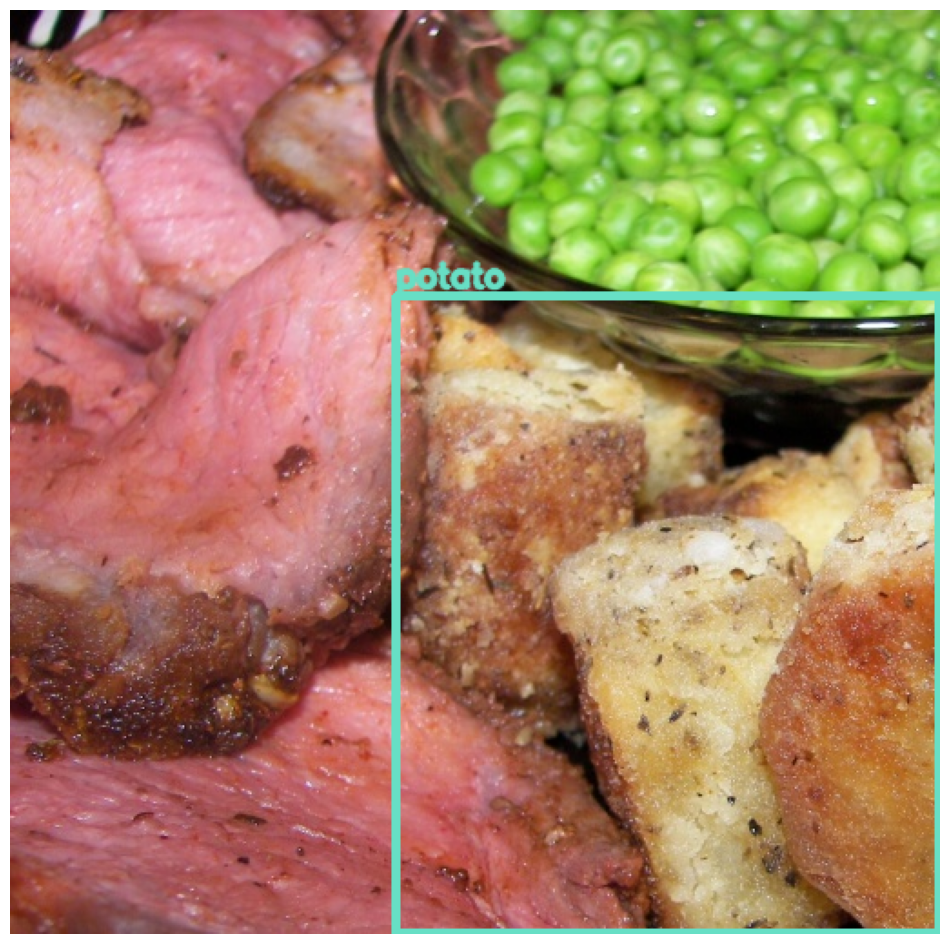

In [ ]:
import json

with open("final_classes.json", "r") as f:
    final_classes = json.load(f)

final_classes = {int(k): v for k, v in final_classes.items()}
image_path = "dataset/train/images/00000432.jpg"
label_det = "dataset/train/labels/00000432.txt"
visualize_yolo_det(image_path, label_det, final_classes)


In [ ]:
import os
import json
from collections import Counter, defaultdict

labels_dir = "dataset/train/labels"
classes_json = "detect_classes_v2.json"

with open(classes_json, "r", encoding="utf-8") as f:
    id_to_name = json.load(f)

object_counts = Counter()          
image_counts = defaultdict(int)   

for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue

    label_path = os.path.join(labels_dir, label_file)
    with open(label_path, "r", encoding="utf-8") as f:
        lines = [l.strip() for l in f if l.strip()]

    file_class_ids = set()

    for line in lines:
        cls_id = line.split()[0]
        object_counts[cls_id] += 1
        file_class_ids.add(cls_id)

    for cls_id in file_class_ids:
        image_counts[cls_id] += 1

sorted_classes = sorted(object_counts.items(), key=lambda x: x[1], reverse=True)

print("📊 YOLO Dataset Class Summary (sorted by object count):")
print(f"{'ID':>4} {'Class Name':<35} {'Objects':>10} {'Images':>10}")
print("-" * 65)

for cls_id, obj_count in sorted_classes:
    name = id_to_name.get(cls_id, "Unknown")
    img_count = image_counts.get(cls_id, 0)
    print(f"{cls_id:>4} {name:<35} {obj_count:>10} {img_count:>10}")

# # === Save to JSON file ===
# summary = {
#     id_to_name.get(k, k): {
#         "object_count": v,
#         "image_count": image_counts.get(k, 0)
#     }
#     for k, v in object_counts.items()
# }

# out_path = "yolo_class_stats_sorted.json"
# with open(out_path, "w", encoding="utf-8") as f:
#     json.dump(summary, f, indent=4)

# print(f"\nSaved summary to {out_path}")


📊 YOLO Dataset Class Summary (sorted by object count):
  ID Class Name                             Objects     Images
-----------------------------------------------------------------
  98 tomato-raw                                5275       3039
  25 carrot                                    4130       2662
  71 pasta                                     3037       2728
  20 bread-white                               2581       2192
  22 bread-wholemeal                           2169       1893
  41 egg                                       1913       1547
  85 rice                                      1903       1655
  63 mixed-vegetables                          1877       1447
  36 cucumber                                  1768       1205
  11 bell-pepper-red-raw                       1631        946
   1 apple                                     1370       1098
  88 salmon                                    1326       1005
   4 avocado                                   1080        7

## Downasmpling tomatoes and carrots

In [ ]:
import os
import random

def downsample_class(class_id: int, labels_dir: str, target_ratio: float = 0.5):
    """
    Downsample an overrepresented YOLO class intelligently.
    """

    label_files = [f for f in os.listdir(labels_dir) if f.endswith(".txt")]
    single_class_files = []
    mixed_files = []

    for file in label_files:
        path = os.path.join(labels_dir, file)
        with open(path, "r") as f:
            lines = f.readlines()
        if not lines:
            continue

        classes_in_file = set(int(line.split()[0]) for line in lines)

        if classes_in_file == {class_id}:
            single_class_files.append(path)
        elif class_id in classes_in_file:
            mixed_files.append(path)

    print(f"Class {class_id}: found {len(single_class_files)} single-class and {len(mixed_files)} mixed-class label files.")

    num_to_keep = int(len(single_class_files) * target_ratio)
    to_remove = random.sample(single_class_files, len(single_class_files) - num_to_keep)

    print(f"Will remove {len(to_remove)} single-class label files ({100*(1-target_ratio):.1f}%).")

    deleted = 0
    for label_path in to_remove:
        img_path = label_path.replace("/labels/", "/images/").rsplit(".", 1)[0] + ".jpg"
        if not os.path.exists(img_path):
            img_path = img_path.replace(".jpg", ".png") if os.path.exists(img_path.replace(".jpg", ".png")) else img_path

        # Delete label
        os.remove(label_path)
        if os.path.exists(img_path):
            os.remove(img_path)
        deleted += 1

    print(f"✅ Deleted {deleted} label-image pairs. Mixed-class files kept intact.")


In [12]:
tomato_id = 98
carrot_id = 25

downsample_class(tomato_id, "dataset/train/labels", target_ratio=0.5)
downsample_class(carrot_id, "dataset/train/labels", target_ratio=0.5)

Class 98: found 636 single-class and 2403 mixed-class label files.
Will remove 318 single-class label files (50.0%).
✅ Deleted 318 label-image pairs. Mixed-class files kept intact.
Class 25: found 674 single-class and 1988 mixed-class label files.
Will remove 337 single-class label files (50.0%).
✅ Deleted 337 label-image pairs. Mixed-class files kept intact.


In [ ]:
import os
import random

def reduce_class_in_mixed_images(class_id: int, labels_dir: str, delete_count: int = 500):
    """
    Removes up to `delete_count` random mixed-class images that contain the specified YOLO class.
    
    Deletes both label and corresponding image files.
    """
    label_files = [f for f in os.listdir(labels_dir) if f.endswith(".txt")]
    mixed_files = []

    for file in label_files:
        label_path = os.path.join(labels_dir, file)
        with open(label_path, "r") as f:
            lines = f.readlines()

        if not lines:
            continue

        classes_in_file = [int(line.split()[0]) for line in lines]
        unique_classes = set(classes_in_file)

        if class_id in unique_classes and len(unique_classes) > 1:
            mixed_files.append(label_path)

    print(f"\nFound {len(mixed_files)} mixed-class images containing class {class_id}")

    if not mixed_files:
        print("No mixed-class files found. Nothing to remove.")
        return

    # Randomly choose files to delete
    to_delete = random.sample(mixed_files, min(delete_count, len(mixed_files)))
    print(f"Removing {len(to_delete)} mixed-class images containing class {class_id}")

    deleted = 0
    for label_path in to_delete:
        os.remove(label_path)
        deleted += 1

        img_base = label_path.replace("/labels/", "/images/").rsplit(".", 1)[0]
        for ext in [".jpg", ".jpeg", ".png"]:
            img_path = img_base + ext
            if os.path.exists(img_path):
                os.remove(img_path)
                break

    print(f"Deleted {deleted} mixed-class labels and corresponding images.")

In [17]:
reduce_class_in_mixed_images(98, "dataset/train/labels", delete_count=500)  # reduce tomato-raw
reduce_class_in_mixed_images(25, "dataset/train/labels", delete_count=500)  # reduce carrot



🔍 Found 2403 mixed-class images containing class 98
🧩 Removing 500 mixed-class images containing class 98
✅ Deleted 500 mixed-class labels and corresponding images.

🔍 Found 1923 mixed-class images containing class 25
🧩 Removing 500 mixed-class images containing class 25
✅ Deleted 500 mixed-class labels and corresponding images.


### Checking the class imbalance fix status

In [ ]:
import os
import json
from collections import Counter, defaultdict

labels_dir = "dataset/train/labels"
classes_json = "detect_classes_v2.json"

with open(classes_json, "r", encoding="utf-8") as f:
    id_to_name = json.load(f)

object_counts = Counter()          
image_counts = defaultdict(int)    

for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue

    label_path = os.path.join(labels_dir, label_file)
    with open(label_path, "r", encoding="utf-8") as f:
        lines = [l.strip() for l in f if l.strip()]

    file_class_ids = set()

    for line in lines:
        cls_id = line.split()[0]
        object_counts[cls_id] += 1
        file_class_ids.add(cls_id)

    for cls_id in file_class_ids:
        image_counts[cls_id] += 1

sorted_classes = sorted(object_counts.items(), key=lambda x: x[1], reverse=True)

print("📊 YOLO Dataset Class Summary (sorted by object count):")
print(f"{'ID':>4} {'Class Name':<35} {'Objects':>10} {'Images':>10}")
print("-" * 65)

for cls_id, obj_count in sorted_classes:
    name = id_to_name.get(cls_id, "Unknown")
    img_count = image_counts.get(cls_id, 0)
    print(f"{cls_id:>4} {name:<35} {obj_count:>10} {img_count:>10}")

📊 YOLO Dataset Class Summary (sorted by object count):
  ID Class Name                             Objects     Images
-----------------------------------------------------------------
  98 tomato-raw                                3310       1836
  71 pasta                                     2929       2643
  20 bread-white                               2552       2164
  25 carrot                                    2283       1423
  22 bread-wholemeal                           2132       1860
  63 mixed-vegetables                          1856       1429
  41 egg                                       1835       1480
  85 rice                                      1835       1591
  36 cucumber                                  1508       1032
  11 bell-pepper-red-raw                       1499        861
   1 apple                                     1364       1094
  88 salmon                                    1284        966
   6 banana                                    1062        8